**MÉTRICAS BÁSICAS DO CONJUNTO DE DADOS**

# **Carregar bibliotecas e dados**

In [90]:
# Importando as bibliotecas necessárias
import pandas as pd
import numpy as np
import tensorflow as tf
import keras
from keras import layers
from keras import optimizers
import sklearn as sl
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score, cross_val_predict, cross_validate, KFold
from sklearn.metrics import make_scorer,mean_squared_error, r2_score, silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns

# Mapas do IBGE
import requests
import json
import geopandas as gpd

r_state=42
np.random.seed(r_state)
tf.random.set_seed(r_state)

RESOLUCAO = 2
TIMEOUT = 30

# CARREGAR OS DADOS E FUNÇÕES AUXILIARES
#Ajustando os dados
# Remoção dos outliers
def carregarDados(op):
    data = pd.read_csv("TABELA_FINAL.csv", sep=';', encoding='latin-1')    
    # Criação das colunas fora do padrão (união dos atributos)
    data['População beneficiária']  = data['Total de beneficiários'] / data['População']
    data['Repasse por beneficiário'] = data['Valor total repassado'] / data['Total de beneficiários']
    data['Repasse por população'] = data['Valor total repassado'] / data['População']
    
    # não altera os dados
    if op == 0:
        return data
    elif op == 1:
        data = data[data['Idese'] > 0.0] #Remove amostras zeradas
        # data = data[data['Total de beneficiários'] < 20000] #Remove amostras com valores muito discrepantes
        return data
    elif op == 2:
        data = data[data['Idese'] > 0.0] #Remove amostras zeradas
        data = data[data['Total de beneficiários'] < 20000] #Remove amostras com valores muito discrepantes
        return data

print(carregarDados(0).shape)


#Variáveis dependentes
totalBeneficiarios = ['Total de beneficiários']
valorRepassado = ['Valor total repassado']
populacaoBeneficiaria = ['População beneficiária']
repassePorBeneficiario = ['Repasse por beneficiário']
repassePopulacao = ['Repasse por população']
dependentesTeste = [totalBeneficiarios, valorRepassado, populacaoBeneficiaria, repassePorBeneficiario, repassePopulacao]

# Variaveis independentes
idese= ['Idese']
blocos = ['Bloco Educação','Bloco Renda','Bloco Saúde']
blocoEducacao = ['Bloco Educação']
blocoEducacaoResumido = ['Ensino Fundamental', 'Ensino Médio', 'Escolaridade Adulta', 'Pré Escola']
blocoEducacaoTodos = ['Anos Finais EF','Anos Iniciais EF', 'Ensino Fundamental', 'Ensino Médio', 'Escolaridade Adulta', 'Pré Escola']
blocoRenda = ['Bloco Renda']
blocoRendaTodos =['Apropriação da Renda', 'Geração da Renda']
blocoSaude = ['Bloco Saúde']
blocoSaudeResumido = ['Condições Gerais de Saúde', 'Longevidade', 'Saúde Materno Infantil']
blocoSaudeTodos = ['Mortes por Causas Evitáveis','Condições Gerais de Saúde','Óbitos por Causas Mal Definidas','Longevidade','Consultas Pré Natal','Mortalidade de Menores de 5 anos','Saúde Materno Infantil']
independenteTodos = ['Idese','Bloco Educação','Bloco Renda','Bloco Saúde','Anos Finais EF','Anos Iniciais EF', 'Ensino Fundamental', 'Ensino Médio', 'Escolaridade Adulta', 'Pré Escola','Apropriação da Renda', 'Geração da Renda','Mortes por Causas Evitáveis','Condições Gerais de Saúde','Óbitos por Causas Mal Definidas','Longevidade','Consultas Pré Natal','Mortalidade de Menores de 5 anos','Saúde Materno Infantil']
independentesTeste = [idese,blocos ,blocoEducacao ,blocoEducacaoResumido,blocoEducacaoTodos,blocoRenda ,blocoRendaTodos ,blocoSaude ,blocoSaudeResumido ,blocoSaudeTodos, independenteTodos]


# Variaveis complementares
populacao = ['População']

# Valores "IDs" dos municípios no IBGE
ibge = ['Nome cidade', 'id cidade','id microrregiao','Nome microrregiao','id mesorregiao','Nome mesorregiao']

print("Dados carregados")

def atributosValores(atr):
    if atr == "Idese":
        return idese
    elif atr == "Blocos individuais":
        return blocos
    elif atr == "Bloco educação individual":
        return blocoEducacao
    elif atr =="Bloco educação resumido":
        return blocoEducacaoResumido
    elif atr == "Bloco educação completo":
        return blocoEducacaoTodos
    elif atr == "Bloco renda individual":
        return blocoRenda
    elif atr == "Bloco renda completo":
        return blocoRendaTodos
    elif atr =="Bloco saúde individual":
        return blocoSaude
    elif atr == "Bloco saúde resumido":
        return blocoSaudeResumido
    elif atr == "Bloco saúde completo":
        return blocoSaudeTodos
    elif atr == "Todos atributos independentes":
        return independenteTodos
    elif atr == 'Total de beneficiários':
        return totalBeneficiarios
    elif atr == 'Valor total repassado':
        return valorRepassado
    elif atr == 'População beneficiária':
        return populacaoBeneficiaria
    elif atr == 'Repasse por beneficiário':
        return repassePorBeneficiario
    elif atr == 'Repasse por população':
        return repassePopulacao
    elif atr == 'ibge':
        return ibge

def independenteNome(independente):
    # Mostrar qual teste está sendo executado
    var_ind = "independente"
    if independente == idese:
        var_ind = "Idese"
    elif independente == blocos:
        var_ind = "Blocos individuais"
    elif independente == blocoEducacao:
        var_ind = "Bloco educação individual"
    elif independente == blocoEducacaoResumido:
        var_ind = "Bloco educação resumido"
    elif independente == blocoEducacaoTodos:
        var_ind = "Bloco educação completo"
    elif independente == blocoRenda:
        var_ind = "Bloco renda individual"
    elif independente == blocoRendaTodos:
        var_ind = "Bloco renda completo"
    elif independente == blocoSaude:
        var_ind = "Bloco saúde individual"
    elif independente == blocoSaudeResumido:
        var_ind = "Bloco saúde resumido"
    elif independente == blocoSaudeTodos:
        var_ind = "Bloco saúde completo"
    elif independente == independenteTodos:
        var_ind = "Todos atributos independentes"
    
    return var_ind

(7455, 32)
Dados carregados


# **MÉTRICAS**

## **PBF TOTAL**

In [34]:
def q25(x):
    return x.quantile(0.25)

def q75(x):
    return x.quantile(0.75)

for variavel in dependentesTeste:
    # Definindo as funções e nomes
    funcoes = ['sum', 'mean', 'std', q25, 'median', q75, 'min', 'max']
    nomes = ['Total', 'Média', 'Desvio padrão', 'Q0', 'Mediana', 'Q1', 'Mínimo', 'Máximo']
    
    # Métricas básicas
    pbf = data[variavel[0]].agg(funcoes)
    pbf.index = nomes
    
    # Calculando a média do total anual
    total_anual = data.groupby('Ano')[variavel[0]].sum()
    media_total_anual = total_anual.mean()
    
    # Inserindo a média do total anual após o Total
    pbf = pbf.to_dict()
    novo_pbf = {}
    for nome, valor in pbf.items():
        novo_pbf[nome] = valor
        if nome == 'Total':
            novo_pbf['Média do total anual'] = media_total_anual
    
    pbf = pd.Series(novo_pbf)
    
    # Encontrando as amostras com valores mínimo e máximo
    min_val = data[variavel[0]].min()
    max_val = data[variavel[0]].max()
    
    min_amostra = data[data[variavel[0]] == min_val][['Nome cidade', 'Ano', variavel[0]]]
    max_amostra = data[data[variavel[0]] == max_val][['Nome cidade', 'Ano', variavel[0]]]
    
    print(f'{variavel[0]}:\n{pbf.to_frame().T.to_string(index=False)}\n')
    print(f'Mínimo(s):\n{min_amostra.to_string(index=False)}\n')
    print(f'Máximo(s):\n{max_amostra.to_string(index=False)}\n')
        
    # Métricas anuais
    pbf_anual = data.groupby('Ano')[variavel[0]].agg(funcoes)
    pbf_anual.columns = nomes
    
    print('Métricas anuais:')
    print(pbf_anual.to_string())
    print('=================================================================\n')

Total de beneficiários:
    Total  Média do total anual      Média  Desvio padrão   Q0  Mediana    Q1  Mínimo  Máximo
6145623.0              409708.2 825.026581    2507.559843 99.0    254.0 668.0     1.0 54272.0

Mínimo(s):
      Nome cidade  Ano  Total de beneficiários
 Boa Vista do Sul 2017                       1
Monte Belo do Sul 2008                       1
Monte Belo do Sul 2010                       1
Monte Belo do Sul 2011                       1
    São Vendelino 2019                       1

Máximo(s):
 Nome cidade  Ano  Total de beneficiários
Porto Alegre 2015                   54272

Métricas anuais:
       Total       Média  Desvio padrão      Q0  Mediana      Q1  Mínimo  Máximo
Ano                                                                             
2007  410540  827.701613    2080.678316  135.75    269.5  703.25       2   32534
2008  367631  741.191532    1808.565027  113.00    238.5  642.00       1   27479
2009  462966  933.399194    2356.437636  129.75    290.5

## **IDESE ESTADO**

In [33]:
def q25(x):
    return x.quantile(0.25)

def q75(x):
    return x.quantile(0.75)

for variavel in independenteTodos:
    # Definindo as funções e nomes
    funcoes = ['mean', 'std', q25, 'median', q75, 'min', 'max']
    nomes = ['Média', 'Desvio padrão', 'Q0', 'Mediana', 'Q1', 'Mínimo', 'Máximo']
    
    # Métricas básicas
    idese = data[variavel].agg(funcoes)
    idese.index = nomes
    
    # Encontrando as amostras com valores mínimo e máximo
    min_val = data[variavel].min()
    max_val = data[variavel].max()
    
    min_amostra = data[data[variavel] == min_val][['Nome cidade', 'Ano', variavel]]
    max_amostra = data[data[variavel] == max_val][['Nome cidade', 'Ano', variavel]]
    
    # print(f'Métricas básicas de IDESE referente ao atributo {variavel}:\n{idese['Média']}')
    print(f' {variavel}:\n {idese.to_frame().T.to_string(index=False)}')
    print(f'Mínimo(s):\n{min_amostra.to_string(index=False)}\n')
    print(f'Máximo(s):\n{max_amostra.to_string(index=False)}\n')
        
    # Métricas anuais
    idese_anual = data.groupby('Ano')[variavel].agg(funcoes)
    idese_anual.columns = nomes
    
    print('Métricas anuais:')
    print(idese_anual.to_string())
    print('=================================================================\n')

 Idese:
    Média  Desvio padrão      Q0  Mediana       Q1   Mínimo  Máximo
0.725285        0.06438 0.68181 0.730506 0.773712 0.498572 0.89599
Mínimo(s):
Nome cidade  Ano    Idese
  Jaquirana 2009 0.498572

Máximo(s):
   Nome cidade  Ano   Idese
Carlos Barbosa 2020 0.89599

Métricas anuais:
         Média  Desvio padrão        Q0   Mediana        Q1    Mínimo    Máximo
Ano                                                                            
2007  0.672798       0.061909  0.628372  0.672940  0.718887  0.518758  0.829596
2008  0.678056       0.061487  0.634828  0.677054  0.726052  0.499881  0.872022
2009  0.686136       0.061449  0.639929  0.687736  0.731190  0.498572  0.849440
2010  0.689920       0.062476  0.640766  0.693576  0.735045  0.510146  0.851099
2011  0.702479       0.062116  0.655058  0.707513  0.748656  0.544406  0.861406
2012  0.708920       0.060487  0.659034  0.710413  0.752298  0.544277  0.876996
2013  0.732661       0.058656  0.691462  0.735514  0.776737  0.56747

In [8]:
# melhor a pior média
valores = []
for variavel in independenteTodos:
    idese = data[variavel].mean()
    valores.append((variavel, idese))

valores_ordenados = sorted(valores, key=lambda x: x[1], reverse=True)

print("Variáveis ordenadas por média (maior para menor):")
print("índice : Valor")
for variavel, valor in valores:
    # print(f'{variavel}: {media:.3f}')
    print(f'{variavel}: {valor:.4f}')

Variáveis ordenadas por média (maior para menor):
índice : Valor
Idese: 0.7253
Bloco Educação: 0.6914
Bloco Renda: 0.6482
Bloco Saúde: 0.8363
Anos Finais EF: 0.6780
Anos Iniciais EF: 0.7608
Ensino Fundamental: 0.7194
Ensino Médio: 0.7607
Escolaridade Adulta: 0.4538
Pré Escola: 0.8317
Apropriação da Renda: 0.6650
Geração da Renda: 0.6314
Mortes por Causas Evitáveis: 0.6187
Condições Gerais de Saúde: 0.7609
Óbitos por Causas Mal Definidas: 0.9032
Longevidade: 0.8982
Consultas Pré Natal: 0.7726
Mortalidade de Menores de 5 anos: 0.9269
Saúde Materno Infantil: 0.8498


# **Graficos PBF/IDESE**

## **Matriz de calor**

In [ ]:
data_filtrado = data.iloc[:, 7:]

dependentes = ["Total de beneficiários", "Valor total repassado", "População beneficiária", "Repasse por beneficiário", "Repasse por população"]

# Aplicar MinMaxScaler nas variáveis dependentes
scaler = MinMaxScaler()
data_normalizado = data_filtrado.copy()
data_normalizado[dependentes] = scaler.fit_transform(data_normalizado[dependentes])

# Separar atributos para a matriz de correlação
atributos_colunas = [col for col in data_normalizado.columns if col not in dependentes and col != 'População']
atributos_linhas = dependentes

# Gerar matriz de correlação
plt.figure(figsize=(12, 10))
corr_matrix = data_normalizado.corr().loc[atributos_linhas, atributos_colunas]
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', center=0, square=False, cbar=True, linewidths=0.5, annot_kws={"size": 10}, vmin=-0.6, vmax=0.9, cbar_kws={"shrink": 1})
plt.tight_layout()
plt.xlabel('Independentes')
plt.ylabel('Dependentes')
plt.savefig('graficos/matriz_de_correlacao.png', dpi=300, bbox_inches='tight')
plt.show()

## **Mapa população-amostras**

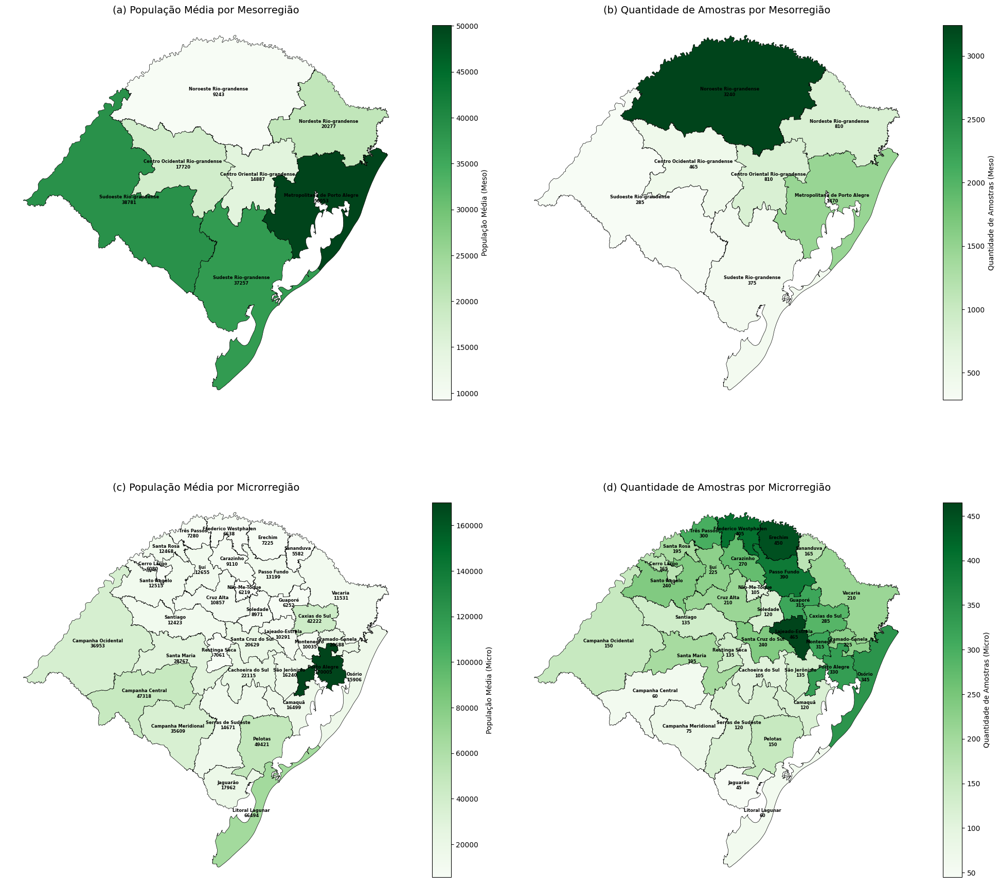

In [93]:
# Criação do mapa para mostrar a média da população da micro/mesorregião
# Criação do mapa para mostrar a quantidade de amostras contidas no conjunto de dados referente a cada micro/mesorregião
data = carregarDados(0)

# Funções de utilidade (mantidas do código anterior)
def baixar_json(url, tentativas=5, espera=3):
    for i in range(tentativas):
        try:
            # Observação: A variável TIMEOUT e requests.get devem estar definidas
            response = requests.get(url, timeout=TIMEOUT) 
            if response.status_code == 200:
                return response.json()
        except Exception as e:
            # Observação: tm.sleep deve estar definida (time.sleep)
            print(f"Erro {i+1}/{tentativas} em {url}: {e}")
            tm.sleep(espera)
    print(f"Falha ao obter dados: {url}")
    return None

def normalizar_texto(texto):
    return (str(texto).upper()
            .strip()
            .replace("-", " ")
            .replace("_", " ")
            .replace("  ", " ")
            .encode("ascii", errors="ignore")
            .decode("ascii"))

# O DataFrame 'data' com as colunas necessárias (População, Nome mesorregiao, Nome microrregiao) é esperado.
# data = carregarDados(0)

# --- Processamento de Mesorregiões ---

## 1. Obter e preparar dados do IBGE (Mesorregiões)
lista_meso = baixar_json("https://servicodados.ibge.gov.br/api/v1/localidades/mesorregioes")
if not lista_meso:
    # Se falhar, pode-se continuar com microrregiões se necessário, ou sair.
    # exit() # Mantido como no original
    print("Falha ao carregar Mesorregiões. Continuando...")
    meso_gdf_unido = None
else:
    local_df_meso = pd.DataFrame([{"id_mesorregiao": item["id"], "nome": item["nome"]} for item in lista_meso])
    local_df_meso["nome_norm"] = local_df_meso["nome"].apply(normalizar_texto)

    ## 2. Calcular estatísticas de Mesorregião
    data_meso = data.rename(columns={"Nome mesorregiao": "nome_regiao", "População": "POPULACAO"})
    meso_stats = data_meso.groupby("nome_regiao").agg(
        POPULACAO=("POPULACAO", "mean"),
        NUM_AMOSTRAS=("nome_regiao", "size")
    ).reset_index()
    meso_stats["nome_norm"] = meso_stats["nome_regiao"].apply(normalizar_texto)

    ## 3. Mesclar estatísticas com IDs do IBGE
    meso_ids_stats = meso_stats.merge(
        local_df_meso[["id_mesorregiao", "nome_norm"]],
        on="nome_norm",
        how="left"
    ).rename(columns={"id_mesorregiao": "id_regiao"})

    ## 4. Coletar IDs únicos e baixar malhas
    ids_meso = meso_ids_stats["id_regiao"].dropna().astype(int).unique().tolist()

    gdf_list_meso = []
    for id_code in ids_meso:
        # Observação: A variável RESOLUCAO deve estar definida
        url = f"https://servicodados.ibge.gov.br/api/v3/malhas/mesorregioes/{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
        geo = baixar_json(url)
        if geo:
            # Observação: geopandas (gpd) deve estar carregado
            gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))
            if not gdf_i.empty:
                gdf_i["id_regiao"] = id_code
                gdf_list_meso.append(gdf_i)

    if not gdf_list_meso:
        print("Falha ao carregar GeoData para Mesorregiões.")
        meso_gdf_unido = None
    else:
        # Concatenar, dissolver e mesclar com as estatísticas
        meso_gdf_unido = (pd.concat(gdf_list_meso, ignore_index=True).set_crs(4326)
                          .dissolve(by="id_regiao", as_index=False))

        meso_gdf_unido = meso_gdf_unido.merge(
            meso_ids_stats[["id_regiao", "nome_regiao", "POPULACAO", "NUM_AMOSTRAS"]],
            on="id_regiao",
            how="left"
        )
        meso_gdf_unido["POPULACAO"] = meso_gdf_unido["POPULACAO"].fillna(0)
        meso_gdf_unido["NUM_AMOSTRAS"] = meso_gdf_unido["NUM_AMOSTRAS"].fillna(0)

        # Dados para vmin/vmax
        min_pop_meso = meso_stats["POPULACAO"].min()
        max_pop_meso = meso_stats["POPULACAO"].max()
        min_amostras_meso = meso_stats["NUM_AMOSTRAS"].min()
        max_amostras_meso = meso_stats["NUM_AMOSTRAS"].max()
        
# --- Processamento de Microrregiões ---

## 1. Obter e preparar dados do IBGE (Microrregiões)
lista_micro = baixar_json("https://servicodados.ibge.gov.br/api/v1/localidades/microrregioes")
if not lista_micro:
    print("Falha ao carregar Microrregiões.")
    micro_gdf_unido = None
else:
    local_df_micro = pd.DataFrame([{"id_microrregiao": item["id"], "nome": item["nome"]} for item in lista_micro])
    local_df_micro["nome_norm"] = local_df_micro["nome"].apply(normalizar_texto)

    ## 2. Calcular estatísticas de Microrregião
    data_micro = data.rename(columns={"Nome microrregiao": "nome_regiao", "População": "POPULACAO"})
    micro_stats = data_micro.groupby("nome_regiao").agg(
        POPULACAO=("POPULACAO", "mean"),
        NUM_AMOSTRAS=("nome_regiao", "size")
    ).reset_index()
    micro_stats["nome_norm"] = micro_stats["nome_regiao"].apply(normalizar_texto)

    ## 3. Mesclar estatísticas com IDs do IBGE
    micro_ids_stats = micro_stats.merge(
        local_df_micro[["id_microrregiao", "nome_norm"]],
        on="nome_norm",
        how="left"
    ).rename(columns={"id_microrregiao": "id_regiao"})

    ## 4. Coletar IDs únicos e baixar malhas
    ids_micro = micro_ids_stats["id_regiao"].dropna().astype(int).unique().tolist()

    gdf_list_micro = []
    for id_code in ids_micro:
        url = f"https://servicodados.ibge.gov.br/api/v3/malhas/microrregioes/{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
        geo = baixar_json(url)
        if geo:
            gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))
            if not gdf_i.empty:
                gdf_i["id_regiao"] = id_code
                gdf_list_micro.append(gdf_i)

    if not gdf_list_micro:
        print("Falha ao carregar GeoData para Microrregiões.")
        micro_gdf_unido = None
    else:
        # Concatenar, dissolver e mesclar com as estatísticas
        micro_gdf_unido = (pd.concat(gdf_list_micro, ignore_index=True).set_crs(4326)
                           .dissolve(by="id_regiao", as_index=False))

        micro_gdf_unido = micro_gdf_unido.merge(
            micro_ids_stats[["id_regiao", "nome_regiao", "POPULACAO", "NUM_AMOSTRAS"]],
            on="id_regiao",
            how="left"
        )
        micro_gdf_unido["POPULACAO"] = micro_gdf_unido["POPULACAO"].fillna(0)
        micro_gdf_unido["NUM_AMOSTRAS"] = micro_gdf_unido["NUM_AMOSTRAS"].fillna(0)
        
        # Dados para vmin/vmax
        min_pop_micro = micro_stats["POPULACAO"].min()
        max_pop_micro = micro_stats["POPULACAO"].max()
        min_amostras_micro = micro_stats["NUM_AMOSTRAS"].min()
        max_amostras_micro = micro_stats["NUM_AMOSTRAS"].max()


# --- Geração da Figura Final (4 Mapas) ---

if meso_gdf_unido is None and micro_gdf_unido is None:
    print("Não foi possível gerar mapas: Falha no carregamento de dados geográficos.")
    # exit() # Se for estritamente necessário um resultado, caso contrário, encerra.
else:
    # 2 linhas, 2 colunas. (ax11, ax12 na primeira linha; ax21, ax22 na segunda)
    fig, axes = plt.subplots(2, 2, figsize=(20, 20))
    ax11, ax12 = axes[0] # Mesorregião
    ax21, ax22 = axes[1] # Microrregião

    # Função auxiliar para plotar e anotar
    def plotar_mapa(ax, gdf, column, min_val, max_val, title_suffix, label, annotation_col):
        if gdf is not None:
            gdf.plot(
                column=column,
                ax=ax,
                legend=True,
                cmap="Greens",
                edgecolor="black",
                linewidth=0.5,
                legend_kwds={"label": label, "shrink": 0.7},
                vmin=min_val,
                vmax=max_val
            )
            ax.set_axis_off()
            ax.set_title(title_suffix, fontsize=14)

            # Adicionar anotações
            for _, row in gdf.iterrows():
                if row[column] > 0:
                    centroid = row.geometry.centroid
                    annotation_text = f"{row['nome_regiao']}\n{row[column]:.0f}" if column == "POPULACAO" else f"{row['nome_regiao']}\n{row[column]}"
                    ax.annotate(
                        annotation_text,
                        xy=(centroid.x, centroid.y),
                        fontsize=6,
                        fontweight='bold',
                        ha="center",
                        va="center"
                    )
        else:
            ax.set_axis_off()
            ax.text(0.5, 0.5, "Dados não disponíveis", transform=ax.transAxes, 
                    ha="center", va="center", fontsize=16, color="red")


    # Mapa 1 (A): População - Mesorregião
    plotar_mapa(ax11, meso_gdf_unido, "POPULACAO", min_pop_meso, max_pop_meso, 
                "(a) População Média por Mesorregião", "População Média (Meso)", "nome_regiao")

    # Mapa 2 (B): Amostras - Mesorregião
    plotar_mapa(ax12, meso_gdf_unido, "NUM_AMOSTRAS", min_amostras_meso, max_amostras_meso, 
                "(b) Quantidade de Amostras por Mesorregião", "Quantidade de Amostras (Meso)", "nome_regiao")

    # Mapa 3 (C): População - Microrregião
    plotar_mapa(ax21, micro_gdf_unido, "POPULACAO", min_pop_micro, max_pop_micro, 
                "(c) População Média por Microrregião", "População Média (Micro)", "nome_regiao")

    # Mapa 4 (D): Amostras - Microrregião
    plotar_mapa(ax22, micro_gdf_unido, "NUM_AMOSTRAS", min_amostras_micro, max_amostras_micro, 
                "(d) Quantidade de Amostras por Microrregião", "Quantidade de Amostras (Micro)", "nome_regiao")

    plt.tight_layout()
    plt.savefig("graficos/mapa_populacao_amostras_meso_micro.png", dpi=500, bbox_inches="tight")
    plt.show()

#

## **MAPAS PBF**

In [ ]:

def norm(x):
    return (
        str(x).upper()
        .strip()
        .replace("-", " ")
        .replace("_", " ")
        .replace("  ", " ")
        .strip()
        .encode("ascii", errors="ignore")
        .decode("ascii")
    )


# ============================
# 1) PREPARAR DADOS DO PBF
# ============================

micro = (data.groupby("Nome microrregiao")[totalBeneficiarios[0]].sum().reset_index()
    .rename(columns={"Nome microrregiao": "nome_microrregiao", totalBeneficiarios[0]: "beneficiarios"})
)

micro["nome_norm"] = micro["nome_microrregiao"].apply(norm)

# ============================
# 2) BAIXAR LISTA OFICIAL DE MICRORREGIÕES (ID + NOME)
# ============================

url_localidades = "https://servicodados.ibge.gov.br/api/v1/localidades/microrregioes"
lista_micro = requests.get(url_localidades, timeout=TIMEOUT).json()

local_df = pd.DataFrame([{
    "id_microrregiao": item["id"],
    "nome": item["nome"]
} for item in lista_micro])

local_df["nome_norm"] = local_df["nome"].apply(norm)

# merge pelo nome
micro_ids = micro.merge(local_df, on="nome_norm", how="left")

# IDs reais a baixar
ids = micro_ids["id_microrregiao"].dropna().astype(int).unique().tolist()


# ============================
# 3) BAIXAR MALHAS APENAS DAS MICRORREGIÕES NECESSÁRIAS
# ============================

gdf_list = []

for id_code in ids:
    url = f"https://servicodados.ibge.gov.br/api/v3/malhas/microrregioes/{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
    r = requests.get(url, timeout=TIMEOUT)
    if r.status_code != 200:
        continue

    geo = r.json()
    gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))
    if gdf_i.empty:
        continue

    gdf_i["id_microrregiao"] = id_code
    gdf_list.append(gdf_i)

gdf_all = pd.concat(gdf_list, ignore_index=True)
gdf_all = gdf_all.set_crs(4326)

# dissolver para garantir 1 geometria por microrregião
gdf_unido = gdf_all.dissolve(by="id_microrregiao", as_index=False)

# adicionar nomes
gdf_unido = gdf_unido.merge(
    micro_ids[["id_microrregiao", "nome_microrregiao", "beneficiarios"]],
    on="id_microrregiao",
    how="left"
)

# completar vazios
gdf_unido["beneficiarios"] = gdf_unido["beneficiarios"].fillna(0)


# ============================
# 5) MAPA
# ============================

fig, ax = plt.subplots(1, 1, figsize=(14, 10))
gdf_unido.plot(
    column="beneficiarios",
    ax=ax,
    legend=True,
    cmap="Greens",
    edgecolor="black",
    linewidth=0.5,
    legend_kwds={"label": "Número de Beneficiários", "shrink": 0.7}
)

ax.set_axis_off()

for _, row in gdf_unido.iterrows():
    if row["beneficiarios"] > 0:
        centroid = row.geometry.centroid
        ax.annotate(
            f"{row['nome_microrregiao']}\n{int(row['beneficiarios']):,}",
            xy=(centroid.x, centroid.y),
            fontsize=6,
            ha="center"
        )

plt.tight_layout()
plt.savefig('graficos/pbf_micro_total-beneficiarios.png', dpi=300, bbox_inches='tight')
plt.show()


# ============================
# 6) RANKING
# ============================

ranking = gdf_unido[["nome_microrregiao", "beneficiarios"]].copy()
ranking = ranking.sort_values("beneficiarios", ascending=False)
ranking["% do total"] = (ranking["beneficiarios"] / ranking["beneficiarios"].sum() * 100).round(2)

print(ranking.head(20).to_string(index=False))


In [ ]:
import requests
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

RESOLUCAO = 2
TIMEOUT = 30

os.makedirs("graficos", exist_ok=True)


def norm(x):
    return (
        str(x).upper()
        .strip()
        .replace("-", " ")
        .replace("_", " ")
        .replace("  ", " ")
        .strip()
        .encode("ascii", errors="ignore")
        .decode("ascii")
    )


# ========================================================
# 1) MESORREGIÕES – PREPARAR DADOS
# ========================================================

meso = (
    data.groupby("Nome mesorregiao")[totalBeneficiarios[0]]
    .sum()
    .reset_index()
    .rename(columns={"Nome mesorregiao": "nome_mesorregiao",
                     totalBeneficiarios[0]: "beneficiarios"})
)

meso["nome_norm"] = meso["nome_mesorregiao"].apply(norm)


# lista oficial do IBGE
url_localidades_meso = "https://servicodados.ibge.gov.br/api/v1/localidades/mesorregioes"
lista_meso = requests.get(url_localidades_meso, timeout=TIMEOUT).json()

local_meso = pd.DataFrame([{
    "id_mesorregiao": item["id"],
    "nome": item["nome"]
} for item in lista_meso])

local_meso["nome_norm"] = local_meso["nome"].apply(norm)

# merger nomes normalizados
meso_ids = meso.merge(local_meso, on="nome_norm", how="left")

# IDs válidos
ids_meso = meso_ids["id_mesorregiao"].dropna().astype(int).unique().tolist()


# ========================================================
# 2) BAIXAR MALHA DAS MESORREGIÕES
# ========================================================

gdf_list_meso = []

for id_code in ids_meso:
    url = f"https://servicodados.ibge.gov.br/api/v3/malhas/mesorregioes/{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
    r = requests.get(url, timeout=TIMEOUT)
    if r.status_code != 200:
        continue

    geo = r.json()
    gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))
    if gdf_i.empty:
        continue

    gdf_i["id_mesorregiao"] = id_code
    gdf_list_meso.append(gdf_i)

gdf_meso = pd.concat(gdf_list_meso, ignore_index=True).set_crs(4326)

# dissolver — 1 geometria por mesorregião
gdf_meso = gdf_meso.dissolve(by="id_mesorregiao", as_index=False)


# adicionar nomes e beneficiários
gdf_meso = gdf_meso.merge(
    meso_ids[["id_mesorregiao", "nome_mesorregiao", "beneficiarios"]],
    on="id_mesorregiao",
    how="left"
)

gdf_meso["beneficiarios"] = gdf_meso["beneficiarios"].fillna(0)


# ========================================================
# 3) MAPA – MESORREGIÕES
# ========================================================

fig, ax = plt.subplots(1, 1, figsize=(14, 10))

gdf_meso.plot(
    column="beneficiarios",
    ax=ax,
    legend=True,
    cmap="Greens",
    edgecolor="black",
    linewidth=0.4,
    legend_kwds={"label": "Beneficiários – Mesorregiões", "shrink": 0.7}
)

# ax.set_title("Mesorregiões – Número de Beneficiários")
ax.set_axis_off()

# adicionar nomes + valores no centro
for _, row in gdf_meso.iterrows():
    if row["beneficiarios"] > 0:
        centroid = row.geometry.centroid
        ax.annotate(
            f"{row['nome_mesorregiao']}\n{int(row['beneficiarios']):,}",
            xy=(centroid.x, centroid.y),
            fontsize=6,
            ha="center"
        )

plt.tight_layout()
plt.savefig("graficos/mapa-meso-beneficiarios.png", dpi=300, bbox_inches="tight")
plt.show()


# ========================================================
# 4) Ranking das mesorregiões
# ========================================================

ranking_meso = (
    gdf_meso[["nome_mesorregiao", "beneficiarios"]]
    .sort_values("beneficiarios", ascending=False)
)
ranking_meso["% do total"] = (
    ranking_meso["beneficiarios"] / ranking_meso["beneficiarios"].sum() * 100
).round(2)

print("\nTOP 20 MESORREGIÕES\n")
print(ranking_meso.head(20).to_string(index=False))


In [ ]:
import requests
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

RESOLUCAO = 2
TIMEOUT = 30

os.makedirs("graficos", exist_ok=True)

def norm(x):
    return (
        str(x).upper()
        .strip()
        .replace("-", " ")
        .replace("_", " ")
        .replace("  ", " ")
        .strip()
        .encode("ascii", errors="ignore")
        .decode("ascii")
    )


# ========================================================
# 1) MICRORREGIÕES – PREPARAR DADOS
# ========================================================

micro = (
    data.groupby("Nome microrregiao")[totalBeneficiarios[0]]
    .sum()
    .reset_index()
    .rename(columns={"Nome microrregiao": "nome_microrregiao",
                     totalBeneficiarios[0]: "beneficiarios"})
)

micro["nome_norm"] = micro["nome_microrregiao"].apply(norm)

# lista oficial dos nomes e IDs
url_micro = "https://servicodados.ibge.gov.br/api/v1/localidades/microrregioes"
lista_micro = requests.get(url_micro, timeout=TIMEOUT).json()

local_df = pd.DataFrame([{
    "id_microrregiao": item["id"],
    "nome": item["nome"]
} for item in lista_micro])

local_df["nome_norm"] = local_df["nome"].apply(norm)

# merge nomes
micro_ids = micro.merge(local_df, on="nome_norm", how="left")

ids_micro = micro_ids["id_microrregiao"].dropna().astype(int).unique().tolist()


# ========================================================
# 2) MICRORREGIÕES – BAIXAR MALHAS
# ========================================================

gdf_list_micro = []

for id_code in ids_micro:
    url = f"https://servicodados.ibge.gov.br/api/v3/malhas/microrregioes/{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
    resp = requests.get(url, timeout=TIMEOUT)
    if resp.status_code != 200:
        continue

    geo = resp.json()
    gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))

    if gdf_i.empty:
        continue

    gdf_i["id_microrregiao"] = id_code
    gdf_list_micro.append(gdf_i)

gdf_micro = pd.concat(gdf_list_micro, ignore_index=True).set_crs(4326)
gdf_micro = gdf_micro.dissolve(by="id_microrregiao", as_index=False)

gdf_micro = gdf_micro.merge(
    micro_ids[["id_microrregiao", "nome_microrregiao", "beneficiarios"]],
    on="id_microrregiao", how="left"
)

gdf_micro["beneficiarios"] = gdf_micro["beneficiarios"].fillna(0)


# ========================================================
# 3) MESORREGIÕES – PREPARAR DADOS
# ========================================================

meso = (
    data.groupby("Nome mesorregiao")[totalBeneficiarios[0]]
    .sum()
    .reset_index()
    .rename(columns={"Nome mesorregiao": "nome_mesorregiao",
                     totalBeneficiarios[0]: "beneficiarios"})
)

meso["nome_norm"] = meso["nome_mesorregiao"].apply(norm)

url_meso = "https://servicodados.ibge.gov.br/api/v1/localidades/mesorregioes"
lista_meso = requests.get(url_meso, timeout=TIMEOUT).json()

local_meso = pd.DataFrame([{
    "id_mesorregiao": item["id"],
    "nome": item["nome"]
} for item in lista_meso])

local_meso["nome_norm"] = local_meso["nome"].apply(norm)

meso_ids = meso.merge(local_meso, on="nome_norm", how="left")
ids_meso = meso_ids["id_mesorregiao"].dropna().astype(int).unique().tolist()


# ========================================================
# 4) MESORREGIÕES – BAIXAR MALHAS
# ========================================================

gdf_list_meso = []

for id_code in ids_meso:
    url = f"https://servicodados.ibge.gov.br/api/v3/malhas/mesorregioes/{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
    resp = requests.get(url, timeout=TIMEOUT)
    if resp.status_code != 200:
        continue

    geo = resp.json()
    gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))

    if gdf_i.empty:
        continue

    gdf_i["id_mesorregiao"] = id_code
    gdf_list_meso.append(gdf_i)

gdf_meso = pd.concat(gdf_list_meso, ignore_index=True).set_crs(4326)
gdf_meso = gdf_meso.dissolve(by="id_mesorregiao", as_index=False)

gdf_meso = gdf_meso.merge(
    meso_ids[["id_mesorregiao", "nome_mesorregiao", "beneficiarios"]],
    on="id_mesorregiao", how="left"
)

gdf_meso["beneficiarios"] = gdf_meso["beneficiarios"].fillna(0)


# ========================================================
# 5) FIGURA FINAL – MICRO + MESO LADO A LADO
# ========================================================

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 12))

# ================= MICRORREGIÕES =================
gdf_micro.plot(
    column="beneficiarios",
    ax=ax1,
    legend=True,
    cmap="Greens",
    edgecolor="black",
    linewidth=0.5,
    legend_kwds={"label": "Beneficiários – Microrregiões", "shrink": 0.6},
    vmin=micro["beneficiarios"].min(),
    vmax=micro["beneficiarios"].max() 
)
ax1.set_title("(a)")
ax1.set_axis_off()

for _, row in gdf_micro.iterrows():
    if row["beneficiarios"] > 0:
        c = row.geometry.centroid
        ax1.annotate(
            f"{row['nome_microrregiao']}\n{int(row['beneficiarios']):,}",
            xy=(c.x, c.y), fontsize=5, ha="center"
        )


# ================= MESORREGIÕES =================
gdf_meso.plot(
    column="beneficiarios",
    ax=ax2,
    legend=True,
    cmap="Greens",
    edgecolor="black",
    linewidth=0.5,
    legend_kwds={"label": "Beneficiários – Mesorregiões", "shrink": 0.6},
    vmin=meso["beneficiarios"].min(),
    vmax=meso["beneficiarios"].max() 
)
ax2.set_title("(b)")
ax2.set_axis_off()

for _, row in gdf_meso.iterrows():
    if row["beneficiarios"] > 0:
        c = row.geometry.centroid
        ax2.annotate(
            f"{row['nome_mesorregiao']}\n{int(row['beneficiarios']):,}",
            xy=(c.x, c.y), fontsize=5, ha="center"
        )

plt.tight_layout()
plt.savefig("graficos/mapas-micro-meso-beneficiarios.png", dpi=300, bbox_inches="tight")
plt.show()

print("\nImagem salva em: graficos/mapas-micro-meso-beneficiarios.png")


## **MAPA IDESE**

In [ ]:
RESOLUCAO = 2
TIMEOUT = 30
os.makedirs("graficos", exist_ok=True)


# ============================
# Funções auxiliares
# ============================

def baixar_json(url, tentativas=5, espera=3):
    """
    Baixa JSON da API do IBGE com repetição automática em caso de falha.
    """
    for i in range(tentativas):
        try:
            r = requests.get(url, timeout=TIMEOUT)
            if r.status_code == 200:
                return r.json()
        except Exception as e:
            print(f"[ERRO] Falha {i+1}/{tentativas} ao acessar {url}: {e}")

        time.sleep(espera)

    print(f"[FALHA] Não foi possível obter dados em: {url}")
    return None


def norm(x):
    return (
        str(x).upper()
        .strip()
        .replace("-", " ")
        .replace("_", " ")
        .replace("  ", " ")
        .strip()
        .encode("ascii", errors="ignore")
        .decode("ascii")
    )


# ============================
# VARIÁVEIS PARA MAPEAR
# ============================

variaveis = ["Idese", "Bloco Educação", "Bloco Renda", "Bloco Saúde"]


# ============================
# PROCESSAMENTO PARA TODAS AS VARIÁVEIS
# ============================

for variavel in variaveis:

    print(f"\n==========================")
    print(f"📌 PROCESSANDO: {variavel}")
    print(f"==========================\n")

    # ============================
    # 1) PREPARAR DADOS
    # ============================

    micro = (
        data.groupby("Nome microrregiao")[variavel]
        .mean()
        .reset_index()
        .rename(columns={
            "Nome microrregiao": "nome_microrregiao",
            variavel: variavel.upper()
        })
    )

    micro["nome_norm"] = micro["nome_microrregiao"].apply(norm)

    # ============================
    # 2) BAIXAR LISTA OFICIAL IBGE
    # ============================

    url_localidades = "https://servicodados.ibge.gov.br/api/v1/localidades/microrregioes"
    lista_micro = baixar_json(url_localidades)

    local_df = pd.DataFrame([
        {"id_microrregiao": item["id"], "nome": item["nome"]}
        for item in lista_micro
    ])
    local_df["nome_norm"] = local_df["nome"].apply(norm)

    # Junta nomes
    micro_ids = micro.merge(local_df, on="nome_norm", how="left")

    # IDs válidos
    ids = micro_ids["id_microrregiao"].dropna().astype(int).unique().tolist()

    # ============================
    # 3) BAIXAR MALHAS
    # ============================

    gdf_list = []

    for id_code in ids:
        url_malha = (
            f"https://servicodados.ibge.gov.br/api/v3/malhas/microrregioes/"
            f"{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
        )

        geo = baixar_json(url_malha)

        if geo is None:
            continue

        gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))

        if gdf_i.empty:
            continue

        gdf_i["id_microrregiao"] = id_code
        gdf_list.append(gdf_i)

    # Une tudo
    gdf_all = pd.concat(gdf_list, ignore_index=True).set_crs(4326)

    # Dissolve → 1 geometria por microrregião
    gdf_unido = gdf_all.dissolve(by="id_microrregiao", as_index=False)

    # Adiciona nomes e variáveis
    gdf_unido = gdf_unido.merge(
        micro_ids[["id_microrregiao", "nome_microrregiao", variavel.upper()]],
        on="id_microrregiao",
        how="left"
    )

    gdf_unido[variavel.upper()] = gdf_unido[variavel.upper()].fillna(0)

    # ============================
    # 4) MAPA
    # ============================

    fig, ax = plt.subplots(1, 1, figsize=(14, 10))

    gdf_unido.plot(
        column=variavel.upper(),
        ax=ax,
        legend=True,
        cmap="Greens",
        edgecolor="black",
        linewidth=0.5,
        legend_kwds={
            "label": f"Valor médio do {variavel}",
            "shrink": 0.7
        },
        vmin=micro[variavel.upper()].min(),
        vmax=micro[variavel.upper()].max()
    )

    ax.set_axis_off()

    # Nomes nos centróides
    for _, row in gdf_unido.iterrows():
        if row[variavel.upper()] > 0:
            centroid = row.geometry.centroid
            ax.annotate(
                f"{row['nome_microrregiao']}\n{row[variavel.upper()]:.3f}",
                xy=(centroid.x, centroid.y),
                fontsize=7,
                ha="center"
            )

    plt.tight_layout()

    nome_arquivo = f"graficos/mapa-{variavel.replace(' ', '_').lower()}.png"
    plt.savefig(nome_arquivo, dpi=300, bbox_inches="tight")
    plt.show()

    # print(f"Mapa salvo em: {nome_arquivo}\n")


In [ ]:
import requests
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import os
import time

# ============================
# CONFIGURAÇÕES
# ============================

RESOLUCAO = 2
TIMEOUT = 30
os.makedirs("graficos", exist_ok=True)

# ============================
# Funções auxiliares
# ============================

def baixar_json(url, tentativas=5, espera=3):
    for i in range(tentativas):
        try:
            r = requests.get(url, timeout=TIMEOUT)
            if r.status_code == 200:
                return r.json()
        except Exception as e:
            print(f"[ERRO] Falha {i+1}/{tentativas} ao acessar {url}: {e}")
        time.sleep(espera)

    print(f"[FALHA] Não foi possível obter dados: {url}")
    return None


def norm(x):
    return (
        str(x).upper()
        .strip()
        .replace("-", " ")
        .replace("_", " ")
        .replace("  ", " ")
        .encode("ascii", errors="ignore")
        .decode("ascii")
    )


# ============================
# VARIÁVEIS PARA MAPEAR
# ============================

variaveis = ["Idese", "Bloco Educação", "Bloco Renda", "Bloco Saúde"]

# Aqui armazenaremos os geodataframes
mapas = {}

# ============================
# PROCESSAMENTO PARA TODAS AS VARIÁVEIS
# ============================

for variavel in variaveis:

    print(f"\n==========================")
    print(f"📌 PROCESSANDO: {variavel}")
    print(f"==========================\n")

    # 1) PREPARAÇÃO DE DADOS
    micro = (
        data.groupby("Nome microrregiao")[variavel]
        .mean()
        .reset_index()
        .rename(columns={
            "Nome microrregiao": "nome_microrregiao",
            variavel: variavel.upper()
        })
    )

    micro["nome_norm"] = micro["nome_microrregiao"].apply(norm)

    # 2) LISTA OFICIAL MICRORREGIÕES IBGE
    url_localidades = "https://servicodados.ibge.gov.br/api/v1/localidades/microrregioes"
    lista_micro = baixar_json(url_localidades)

    local_df = pd.DataFrame([
        {"id_microrregiao": item["id"], "nome": item["nome"]}
        for item in lista_micro
    ])
    local_df["nome_norm"] = local_df["nome"].apply(norm)

    micro_ids = micro.merge(local_df, on="nome_norm", how="left")
    ids = micro_ids["id_microrregiao"].dropna().astype(int).unique().tolist()

    # 3) BAIXAR MALHAS
    gdf_list = []

    for id_code in ids:
        url_malha = (
            f"https://servicodados.ibge.gov.br/api/v3/malhas/microrregioes/"
            f"{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
        )

        geo = baixar_json(url_malha)
        if geo is None:
            continue

        gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))

        if gdf_i.empty:
            continue

        gdf_i["id_microrregiao"] = id_code
        gdf_list.append(gdf_i)

    gdf_all = pd.concat(gdf_list, ignore_index=True).set_crs(4326)
    gdf_unido = gdf_all.dissolve(by="id_microrregiao", as_index=False)

    gdf_unido = gdf_unido.merge(
        micro_ids[["id_microrregiao", "nome_microrregiao", variavel.upper()]],
        on="id_microrregiao",
        how="left"
    )

    gdf_unido[variavel.upper()] = gdf_unido[variavel.upper()].fillna(0)

    mapas[variavel] = (gdf_unido, micro)  # armazenamos para o fig final


# =====================================================================
# 5) GERAR APENAS 1 FIGURA COM OS 4 MAPAS (2x2)
# =====================================================================

fig, axes = plt.subplots(2, 2, figsize=(22, 18))
axes = axes.flatten()

for ax, variavel in zip(axes, variaveis):

    gdf_unido, micro = mapas[variavel]

    gdf_unido.plot(
        column=variavel.upper(),
        ax=ax,
        legend=True,
        cmap="Greens",
        edgecolor="black",
        linewidth=0.4,
        legend_kwds={"label": f"{variavel}", "shrink": 0.6},
        vmin=micro[variavel.upper()].min(),
        vmax=micro[variavel.upper()].max()
    )

    ax.set_title(variavel, fontsize=14)
    ax.set_axis_off()

    # nomes nos centróides
    for _, row in gdf_unido.iterrows():
        valor = row[variavel.upper()]
        if valor > 0:
            cent = row.geometry.centroid
            ax.annotate(
                f"{row['nome_microrregiao']}\n{valor:.3f}",
                xy=(cent.x, cent.y),
                fontsize=7,
                ha="center"
            )

plt.tight_layout()
plt.savefig("graficos/mapas-4-variaveis.png", dpi=300, bbox_inches="tight")
plt.show()

print("\n📌 Arquivo final gerado: graficos/mapas-4-variaveis.png")


## **Barras IDESE micro/mesorregião**

In [ ]:
idese_valores_micro = data.groupby('Nome microrregiao')[['Idese','Bloco Educação', 'Bloco Renda', 'Bloco Saúde']].mean().round(4).reset_index()
idese_valores_meso = data.groupby('Nome mesorregiao')[['Idese','Bloco Educação', 'Bloco Renda', 'Bloco Saúde']].mean().round(4).reset_index()

# Transformar em formato "long"
mirco_convertido = pd.melt(idese_valores_micro, id_vars='Nome microrregiao',
                  value_vars=['Idese','Bloco Educação', 'Bloco Renda', 'Bloco Saúde'],
                  var_name='Indicador', value_name='Valor')

meso_convertido = pd.melt(idese_valores_meso, id_vars='Nome mesorregiao',
                  value_vars=['Idese','Bloco Educação', 'Bloco Renda', 'Bloco Saúde'],
                  var_name='Indicador', value_name='Valor')

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14 ,16))

sns.barplot(data=mirco_convertido, y='Valor', x='Nome microrregiao', hue='Indicador', 
           palette=['lime', 'red', 'yellow', 'blue'], zorder=2, ax=ax1)
ax1.set_title('Valores Médios do IDESE e Blocos principais\npor Microrregião do RS', fontsize=16)
ax1.legend(title='Índice', loc='upper left', fontsize=6)
ax1.set_ylabel('Valor médio do índice', fontsize=14)
ax1.set_xlabel('Microrregião', fontsize=14)
ax1.set_ylim(0, 1)
ax1.set_yticks(np.arange(0, 1.05, 0.05))
ax1.tick_params(axis='x', rotation=90, labelsize=11)
ax1.tick_params(axis='y', labelsize=10)
ax1.grid(True, zorder=1)
ax1.text(-3, 0, '(a)', fontsize=14)

sns.barplot(data=meso_convertido, y='Valor', x='Nome mesorregiao', hue='Indicador',
           palette=['lime', 'red', 'yellow', 'blue'], zorder=2, ax=ax2)
ax2.set_title('Valores Médios do IDESE e Blocos principais\npor Mesorregião do RS', fontsize=16)
ax2.legend(title='Índice', loc='upper left', fontsize=8)
ax2.set_ylabel('Valor médio do índice', fontsize=16)
ax2.set_xlabel('Mesorregião', fontsize=16)
ax2.set_ylim(0, 1)
ax2.set_yticks(np.arange(0, 1.1, 0.1))
ax2.tick_params(axis='x', rotation=90, labelsize=12)
ax2.tick_params(axis='y', labelsize=12)
ax2.grid(True, zorder=1)
ax2.text(-1, 0, '(b)', fontsize=14)

fig.add_artist(plt.Line2D([0, 1], [0.53, 0.53], transform=fig.transFigure, color='black', linewidth=1))
plt.tight_layout()
plt.show()


## **MAPA IDESEs MESORREGIÃO**

Processando: Idese


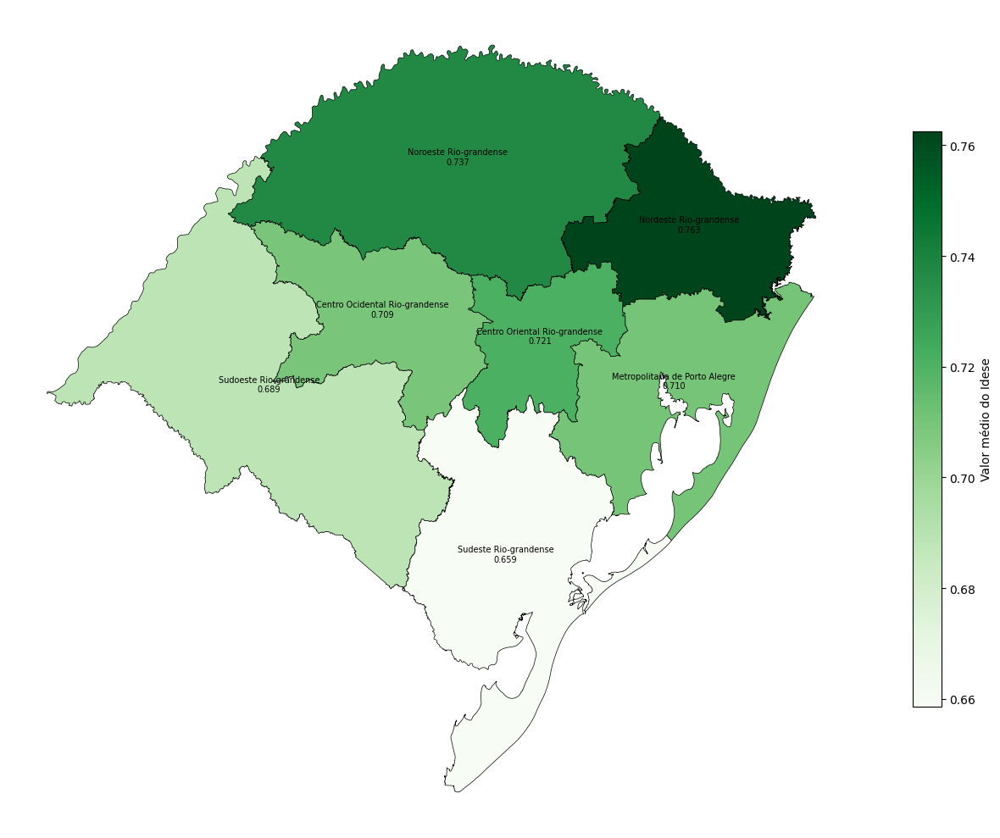

Processando: Bloco Educação


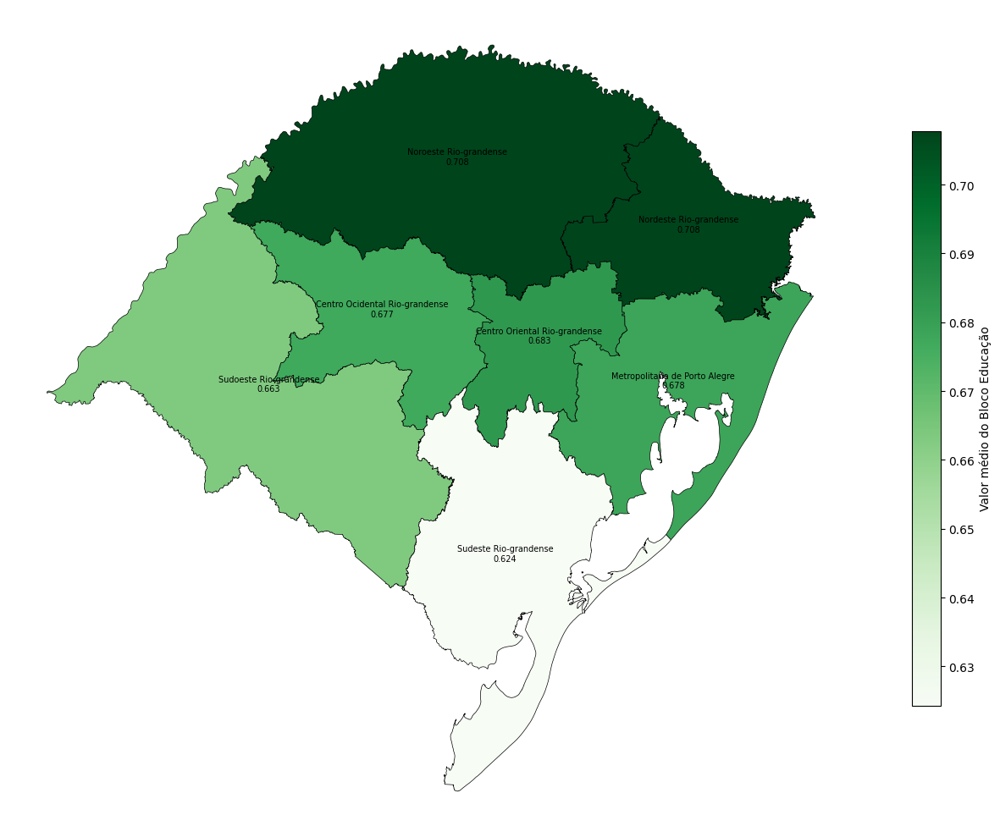

Processando: Bloco Renda


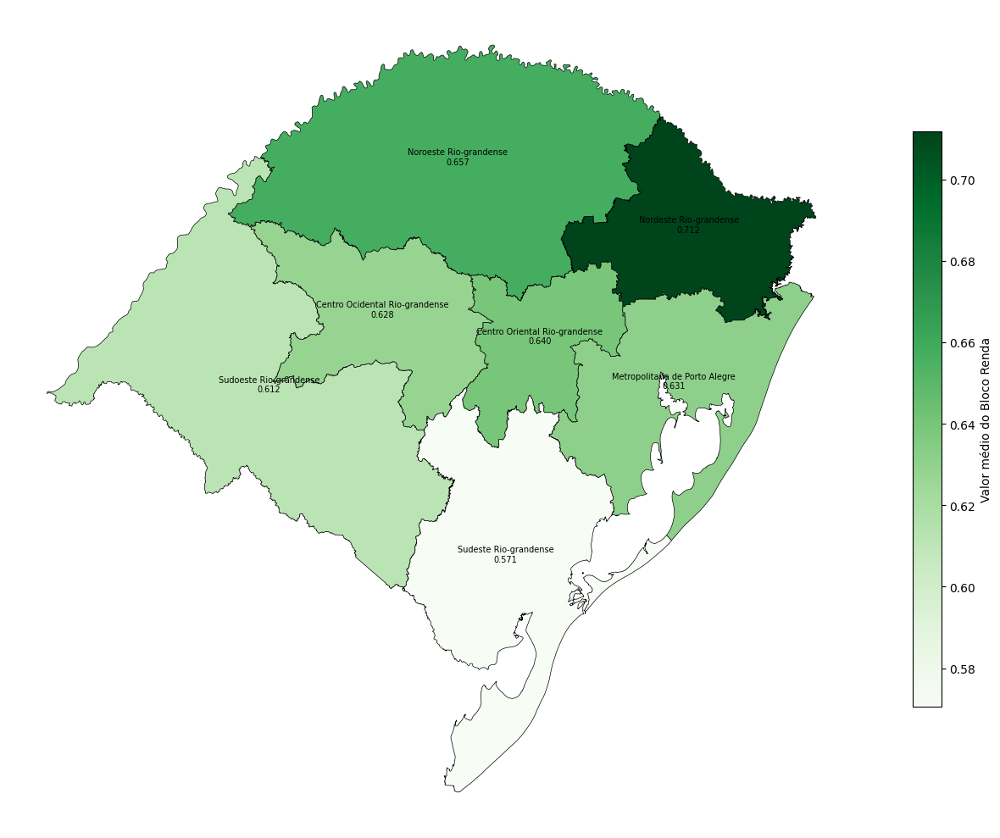

Processando: Bloco Saúde


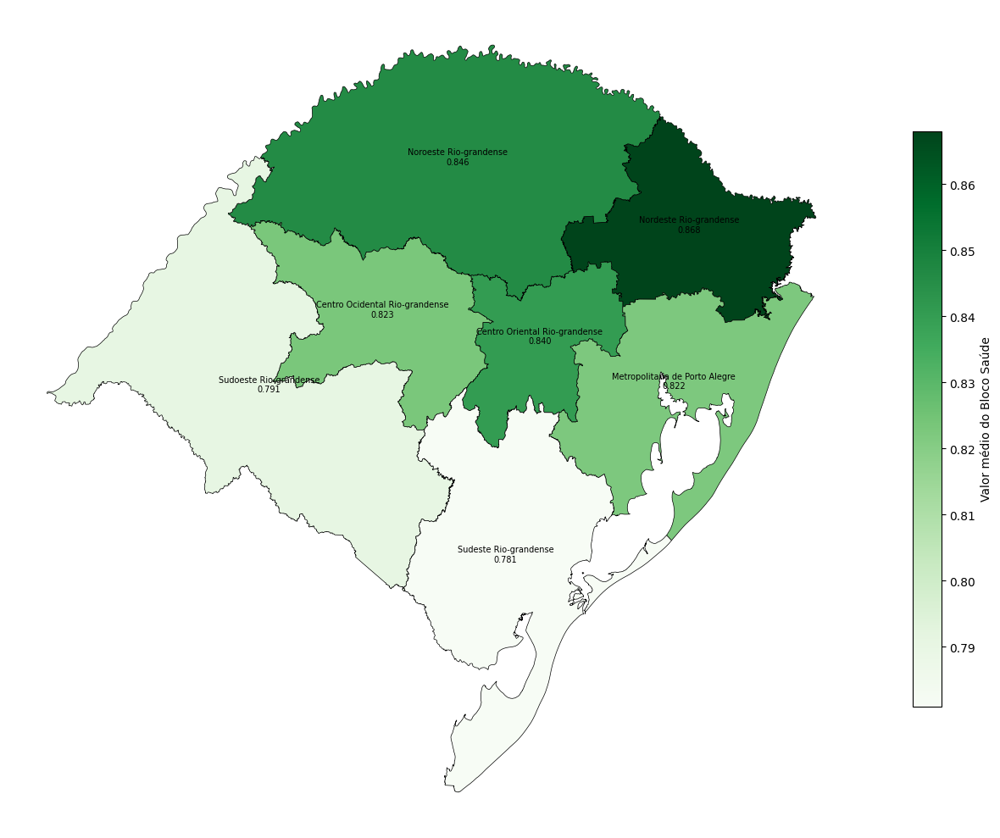

In [58]:
# IDESE MESORREGIÃO SEPARADOS
def baixar_json(url, tentativas=5, espera=3):
    for i in range(tentativas):
        try:
            response = requests.get(url, timeout=TIMEOUT)
            if response.status_code == 200:
                return response.json()
        except Exception as e:
            print(f"Erro {i+1}/{tentativas} em {url}: {e}")
            time.sleep(espera)
    print(f"Falha ao obter dados: {url}")
    return None

def normalizar_texto(texto):
    return (str(texto).upper()
            .strip()
            .replace("-", " ")
            .replace("_", " ")
            .replace("  ", " ")
            .encode("ascii", errors="ignore")
            .decode("ascii"))

variaveis = ["Idese",'Bloco Educação','Bloco Renda','Bloco Saúde']

for variavel in variaveis:
    print(f"Processando: {variavel}")
    
    meso = (data.groupby("Nome mesorregiao")[variavel]
            .mean()
            .reset_index()
            .rename(columns={"Nome mesorregiao": "nome_mesorregiao", variavel: variavel.upper()}))
    
    meso["nome_norm"] = meso["nome_mesorregiao"].apply(normalizar_texto)

    lista_meso = baixar_json("https://servicodados.ibge.gov.br/api/v1/localidades/mesorregioes")
    if not lista_meso:
        continue

    local_df = pd.DataFrame([{"id_mesorregiao": item["id"], "nome": item["nome"]} for item in lista_meso])
    local_df["nome_norm"] = local_df["nome"].apply(normalizar_texto)
    
    meso_ids = meso.merge(local_df, on="nome_norm", how="left")
    ids = meso_ids["id_mesorregiao"].dropna().astype(int).unique().tolist()

    gdf_list = []
    for id_code in ids:
        url = f"https://servicodados.ibge.gov.br/api/v3/malhas/mesorregioes/{id_code}?resolucao={RESOLUCAO}&formato=application/vnd.geo+json"
        geo = baixar_json(url)
        if geo:
            gdf_i = gpd.GeoDataFrame.from_features(geo.get("features", []))
            if not gdf_i.empty:
                gdf_i["id_mesorregiao"] = id_code
                gdf_list.append(gdf_i)

    if not gdf_list:
        continue

    gdf_all = pd.concat(gdf_list, ignore_index=True).set_crs(4326)
    gdf_unido = gdf_all.dissolve(by="id_mesorregiao", as_index=False)
    
    gdf_unido = gdf_unido.merge(
        meso_ids[["id_mesorregiao", "nome_mesorregiao", variavel.upper()]],
        on="id_mesorregiao",
        how="left"
    )
    
    gdf_unido[variavel.upper()] = gdf_unido[variavel.upper()].fillna(0)

    fig, ax = plt.subplots(figsize=(14, 10))
    gdf_unido.plot(
        column=variavel.upper(),
        ax=ax,
        legend=True,
        cmap="Greens",
        edgecolor="black",
        linewidth=0.5,
        legend_kwds={"label": f"Valor médio do {variavel}", "shrink": 0.7},
        vmin=meso[variavel.upper()].min(),
        vmax=meso[variavel.upper()].max()
    )

    ax.set_axis_off()

    for _, row in gdf_unido.iterrows():
        if row[variavel.upper()] > 0:
            centroid = row.geometry.centroid
            ax.annotate(
                f"{row['nome_mesorregiao']}\n{row[variavel.upper()]:.3f}",
                xy=(centroid.x, centroid.y),
                fontsize=7,
                ha="center"
            )

    plt.tight_layout()
    plt.savefig(f"graficos/mapa-{variavel.replace(' ', '_').lower()}.png", dpi=500, bbox_inches="tight")
    plt.show()

## **Barras PBF**

In [ ]:
data_anual = data.groupby('Ano')[['Total de beneficiários','Valor total repassado']].sum().reset_index()
data_media = data.groupby('Ano')[['Repasse por beneficiário','Repasse por população','População beneficiária']].mean().reset_index().astype(float) 
data_anual['Total de beneficiários'] = data_anual['Total de beneficiários']/1000
data_anual['Valor total repassado'] = data_anual['Valor total repassado'].astype(float) /1000000

# Beneficiários
fig, ax1 = plt.subplots(figsize=(12,4))
sns.barplot(y='Total de beneficiários', x='Ano', data=data_anual, color='#007236', ax=ax1)
for i, row in data_anual.iterrows():
    ax1.text(i, row['Total de beneficiários'], f'{int(row["Total de beneficiários"])}', ha='center', va='bottom', fontsize=12)
# ax1.set_title('Quantidade total defamílias beneficiárias do PBF no RS entre 2007 e 2021', fontsize=16)
ax1.set_ylabel('Beneficiários (Mil)', fontsize=14)
ax1.set_xlabel('Ano', fontsize=14)
ax1.tick_params(axis='y', labelsize=14)
ax1.set_ylim(0, 530)
ax1.tick_params(axis='x', labelsize=14)
# plt.savefig('graficos/pbf_TB_anual.png', dpi=300, bbox_inches='tight')
plt.show()

# Repassado
fig, ax2 = plt.subplots(figsize=(12,4))
sns.barplot(y='Valor total repassado', x='Ano', data=data_anual, color='#007236', ax=ax2)
for i, row in data_anual.iterrows():
    ax2.text(i, row['Valor total repassado'], f'{int(row["Valor total repassado"])}', ha='center', va='bottom', fontsize=12)
# ax2.set_title('Repasse total do PBF no RS entre 2007 e 2021', fontsize=16)
ax2.set_ylabel('Repasse (Milhões de R$)', fontsize=14)
ax2.set_xlabel('Ano', fontsize=14)
ax2.tick_params(axis='y', labelsize=14)
ax2.tick_params(axis='x', labelsize=14)
ax2.set_ylim(0, 920)
plt.savefig('graficos/pbf_VTR_anual_barras.png', dpi=300, bbox_inches='tight')
plt.show()

fig, ax3 = plt.subplots(figsize=(12,4))
sns.barplot(y='População beneficiária', x='Ano', data=data_media, color='#007236', ax=ax3)
for i, row in data_media.iterrows():
    ax3.text(i, row['População beneficiária'], f'{row["População beneficiária"]:.4f}', ha='center', va='bottom', fontsize=12)
ax3.set_title('População beneficiária do PBF no RS entre 2007 e 2021', fontsize=16)
ax3.set_ylabel('População beneficiária (%)', fontsize=14)
ax3.set_xlabel('Ano', fontsize=14)
ax3.tick_params(axis='y', labelsize=14)
ax3.tick_params(axis='x', labelsize=14)
ax3.set_ylim(0.0000,0.0650)
plt.show()

# Repasse por beneficiario
fig, ax3 = plt.subplots(figsize=(12,4))
sns.barplot(y='Repasse por beneficiário', x='Ano', data=data_media, color='#007236', ax=ax3)
for i, row in data_media.iterrows():
    ax3.text(i, row['Repasse por beneficiário'], f'{row["Repasse por beneficiário"]:.1f}', ha='center', va='bottom', fontsize=11)
ax3.set_title('Repasse por beneficiário do PBF no RS entre 2007 e 2021', fontsize=16)
ax3.set_ylabel('Repasse por beneficiário (R$)', fontsize=14)
ax3.set_xlabel('Ano', fontsize=14)
ax3.tick_params(axis='y', labelsize=14)
ax3.tick_params(axis='x', labelsize=14)
ax3.set_ylim(0.00,2500.00)
plt.show()

# Repasse por população
fig, ax3 = plt.subplots(figsize=(12,4))
sns.barplot(y='Repasse por população', x='Ano', data=data_media, color='#007236', ax=ax3)
for i, row in data_media.iterrows():
    ax3.text(i, row['Repasse por população'], f'{row["Repasse por população"]:.4f}', ha='center', va='bottom', fontsize=12)
ax3.set_title('Repasse por população do PBF no RS entre 2007 e 2021', fontsize=16)
ax3.set_ylabel('Repasse por população (R$)', fontsize=14)
ax3.set_xlabel('Ano', fontsize=14)
ax3.tick_params(axis='y', labelsize=14)
ax3.tick_params(axis='x', labelsize=14)
# ax3.set_ylim(0.0000,0.0650)
plt.show()

## **PBF micro/mesorregião**

In [ ]:
total_anual_beneficiarios = data.groupby('Ano')[totalBeneficiarios[0]].mean().reset_index()
media_micro = data.groupby('Nome microrregiao')[[totalBeneficiarios[0], valorRepassado[0]]].mean().reset_index()
# media_micro = data.groupby('Nome microrregiao')[totalBeneficiarios[0]].sum().reset_index()
media_micro[valorRepassado[0]] = media_micro[valorRepassado[0]].astype(float) / 1000000
media_meso = data.groupby('Nome mesorregiao')[[totalBeneficiarios[0], valorRepassado[0]]].mean().reset_index()
media_meso[valorRepassado[0]] = media_meso[valorRepassado[0]].astype(float) / 1000000

# figura com 4 gráficos
fig, axes = plt.subplots(2, 2, figsize=(20, 16))

# Gráfico 1: Beneficiários por microrregião
sns.barplot(x=totalBeneficiarios[0], y='Nome microrregiao', data=media_micro, color='#007236', ax=axes[0,0])
for i, row in media_micro.iterrows():
    axes[0,0].text(row[totalBeneficiarios[0]] + 5, i, f'{int(row[totalBeneficiarios[0]])}', va='center', fontsize=11)
# axes[0,0].set_title('Quantidade média de beneficiários\npor microrregião do RS\n(a)', fontsize=16)
axes[0,0].set_title('(a)', fontsize=14)
axes[0,0].set_ylabel('Microrregião', fontsize=14)
axes[0,0].set_xlabel('Quantidade média de Beneficiários', fontsize=14)
axes[0,0].tick_params(axis='y', labelsize=16)
axes[0,0].tick_params(axis='x', labelsize=12)
axes[0,0].set_xlim(0, 6500)
# axes[0,0].text(0, 0, '(a)',  fontsize=12)

# Gráfico 2: Beneficiários por mesorregião
sns.barplot(x=totalBeneficiarios[0], y='Nome mesorregiao', data=media_meso, color='#007236', ax=axes[0,1])
for i, row in media_meso.iterrows():
    axes[0,1].text(row[totalBeneficiarios[0]] + 5, i, f'{int(row[totalBeneficiarios[0]])}', va='center', fontsize=14)
# axes[0,1].set_title('Quantidade média de beneficiários\npor mesorregião do RS\n(b)', fontsize=16)
axes[0,1].set_title('(b)', fontsize=14)
axes[0,1].set_ylabel('Mesorregião', fontsize=16)
axes[0,1].set_xlabel('Quantidade média de Beneficiários', fontsize=16)
axes[0,1].tick_params(axis='x', labelsize=14)
axes[0,1].tick_params(axis='y', labelsize=14)
axes[0,1].set_xlim(0, 3000)

# Gráfico 3: Repasse por microrregião
sns.barplot(x=valorRepassado[0], y='Nome microrregiao', data=media_micro, color='#007236', ax=axes[1,0])
for i, row in media_micro.iterrows():
    axes[1,0].text(row[valorRepassado[0]], i, f'{row[valorRepassado[0]]:.2f}', va='center', fontsize=12)
# axes[1,0].set_title('Média de repasse\npor microrregião do RS\n(a)', fontsize=16)
axes[1,0].set_title('(c)', fontsize=14)
axes[1,0].set_ylabel('Microrregião', fontsize=14)
axes[1,0].set_xlabel('Repasse médio (Milhões de R$)', fontsize=14)
axes[1,0].tick_params(axis='y', labelsize=12)
axes[1,0].tick_params(axis='x', labelsize=12)
axes[1,0].set_xlim(0.0, 9.5)
# axes[1,0].text(0, 0, '(a)',  fontsize=12)

# Gráfico 4: Repasse por mesorregião
sns.barplot(x=valorRepassado[0], y='Nome mesorregiao', data=media_meso, color='#007236', ax=axes[1,1])
for i, row in media_meso.iterrows():
    axes[1,1].text(row[valorRepassado[0]], i, f'{row[valorRepassado[0]]:.2f}', va='center', fontsize=18)
# axes[1,1].set_title('Média de repasse\npor mesorregião do RS\n(b)', fontsize=16)
axes[1,1].set_title('(d)', fontsize=16)
axes[1,1].set_ylabel('Mesorregião', fontsize=16)
axes[1,1].set_xlabel('Repasse médio (Milhões de R$)', fontsize=16)
axes[1,1].tick_params(axis='x', labelsize=14)
axes[1,1].tick_params(axis='y', labelsize=18)
axes[1,1].set_xlim(0.0, 4.1)
# axes[1,1].text(0,0, 'a', fontsize=18)

plt.tight_layout()
plt.savefig('graficos/PBF_micro-meso_media.png', dpi=300, bbox_inches='tight')
plt.show()

## **BOXPLOT PBF**

In [ ]:
# #total de beneficiarios
# plt.figure(figsize=(12, 6))
# sns.boxplot(y='Total de beneficiários', x='Ano', data=data, color='#007236')
# # plt.title('Evolução da quantidade de população beneficiária do PBF\nentre 2007 e 2021 no RS',fontsize=18)
# plt.xlabel('Ano',fontsize=16)
# plt.ylabel('Total de beneficiários',fontsize=16)
# plt.yticks(fontsize=14)
# plt.xticks(fontsize=14)
# plt.grid(True)
# plt.savefig('graficos/pbf_TB_anual_bxp.png', dpi=300, bbox_inches='tight')
# plt.show()

# Valor repassado
plt.figure(figsize=(12, 6))
sns.boxplot(y='Valor total repassado', x='Ano', data=data, color='#007236')
# plt.title('Evolução do Valor total repassado do PBF aos município\nentre 2007 e 2021 no RS',fontsize=18)
plt.xlabel('Ano',fontsize=16)
plt.ylabel('Valor total repassado (R$)',fontsize=16)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.grid(True)
plt.savefig('graficos/pbf_VTR_anual_bxp.png', dpi=300, bbox_inches='tight')
plt.show()

# plt.figure(figsize=(12, 6))
# sns.boxplot(y='População beneficiária', x='Ano', data=data, color='#007236')
# plt.title('Evolução do porcentagem da população beneficiária do PBF\nentre 2007 e 2021 no RS',fontsize=18)
# plt.xlabel('Ano',fontsize=16)
# plt.ylabel('População atendida pelo PBF (%)',fontsize=16)
# plt.yticks(fontsize=14)
# plt.xticks(fontsize=14)
# plt.grid(True)
# plt.show()


# plt.figure(figsize=(12, 6))
# sns.boxplot(y='Repasse por beneficiário', x='Ano', data=data, color='#007236')
# plt.title('Evolução do valor repassado por beneficiários do PBF do município\nentre 2007 e 2021 no RS',fontsize=18)
# plt.xlabel('Ano',fontsize=16)
# plt.ylabel('Valor repassado (R$)',fontsize=16)
# plt.yticks(fontsize=14)
# plt.xticks(fontsize=14)
# plt.grid(True)
# plt.show()


# plt.figure(figsize=(12, 6))
# sns.boxplot(y='Repasse por população', x='Ano', data=data, color='#007236')
# plt.title('Evolução do valor repassado por população do município\nentre 2007 e 2021 no RS',fontsize=18)
# plt.xlabel('Ano',fontsize=16)
# plt.ylabel('Valor repassado (R$)',fontsize=16)
# plt.yticks(fontsize=14)
# plt.xticks(fontsize=14)
# plt.grid(True)
# plt.show()


## **BOXPLOT IDESE**

In [ ]:
# IDESE
plt.figure(figsize=(10, 5))
sns.boxplot(y='Idese', x='Ano', data=data, color='lightgreen')
# plt.title('Evolução da valor do IDESE\nentre 2007 e 2021 no RS',fontsize=18)
plt.xlabel('Ano',fontsize=12)
plt.ylabel('IDESE',fontsize=12)
plt.yticks(fontsize=10)
plt.xticks(fontsize=10)
plt.grid(True)
plt.ylim(0.000, 1.000)
# plt.savefig('graficos/IDESE_valor_principal.png', dpi=300, bbox_inches='tight')
plt.show()
# BLOCO EDUCAÇÃO
plt.figure(figsize=(10, 5))
sns.boxplot(y='Bloco Educação', x='Ano', data=data, color='lightgreen')
# plt.title('Evolução da valor do IDESE\nentre 2007 e 2021 no RS',fontsize=18)
plt.xlabel('Ano',fontsize=12)
plt.ylabel('Bloco educação',fontsize=12)
plt.yticks(fontsize=10)
plt.xticks(fontsize=10)
plt.grid(True)
plt.ylim(0.000, 1.000)
# plt.savefig('graficos/IDESE_valor_principal.png', dpi=300, bbox_inches='tight')
plt.show()
# Bloco renda
plt.figure(figsize=(10, 5))
sns.boxplot(y='Bloco Renda', x='Ano', data=data, color='lightgreen')
# plt.title('Evolução da valor do IDESE\nentre 2007 e 2021 no RS',fontsize=18)
plt.xlabel('Ano',fontsize=12)
plt.ylabel('Bloco renda',fontsize=12)
plt.yticks(fontsize=10)
plt.xticks(fontsize=10)
plt.grid(True)
plt.ylim(0.000, 1.000)
# plt.savefig('graficos/IDESE_valor_principal.png', dpi=300, bbox_inches='tight')
plt.show()
# Bloco saúde
plt.figure(figsize=(10, 5))
sns.boxplot(y='Bloco Saúde', x='Ano', data=data, color='lightgreen')
# plt.title('Evolução da valor do IDESE\nentre 2007 e 2021 no RS',fontsize=18)
plt.xlabel('Ano',fontsize=12)
plt.ylabel('Bloco saúde',fontsize=12)
plt.yticks(fontsize=10)
plt.xticks(fontsize=10)
plt.grid(True)
plt.ylim(0.000, 1.000)
# plt.savefig('graficos/IDESE_valor_principal.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
# Criar figura com 4 subplots (2x2)
fig, axes = plt.subplots(2, 2, figsize=(14, 6))

# Ajustar o espaçamento entre os subplots
plt.subplots_adjust(hspace=0.3, wspace=0.3)

# 1. IDESE
sns.boxplot(y='Idese', x='Ano', data=data, color='lightgreen', ax=axes[0,0])
axes[0,0].set_xlabel('Ano', fontsize=10)
axes[0,0].set_ylabel('IDESE', fontsize=10)
axes[0,0].tick_params(axis='y', labelsize=8)
axes[0,0].tick_params(axis='x', labelsize=8)
axes[0,0].grid(True)
axes[0,0].set_ylim(0.000, 1.000)
# axes[0,0].set_title('(a) IDESE - Índice de Desenvolvimento Socioeconômico', fontsize=13, fontweight='bold')
axes[0,0].set_title('(a)')

# 2. BLOCO EDUCAÇÃO
sns.boxplot(y='Bloco Educação', x='Ano', data=data, color='lightgreen', ax=axes[0,1])
axes[0,1].set_xlabel('Ano', fontsize=10)
axes[0,1].set_ylabel('Bloco Educação', fontsize=10)
axes[0,1].tick_params(axis='y', labelsize=8)
axes[0,1].tick_params(axis='x', labelsize=8)
axes[0,1].grid(True)
axes[0,1].set_ylim(0.000, 1.000)
# axes[0,1].set_title('(b) Bloco Educação', fontsize=13, fontweight='bold')
axes[0,1].set_title('(b)')

# 3. BLOCO RENDA
sns.boxplot(y='Bloco Renda', x='Ano', data=data, color='lightgreen', ax=axes[1,0])
axes[1,0].set_xlabel('Ano', fontsize=10)
axes[1,0].set_ylabel('Bloco Renda', fontsize=10)
axes[1,0].tick_params(axis='y', labelsize=8)
axes[1,0].tick_params(axis='x', labelsize=8)
axes[1,0].grid(True)
axes[1,0].set_ylim(0.000, 1.000)
# axes[1,0].set_title('(c) Bloco Renda', fontsize=13, fontweight='bold')
axes[1,0].set_title('(c)')

# 4. BLOCO SAÚDE
sns.boxplot(y='Bloco Saúde', x='Ano', data=data, color='lightgreen', ax=axes[1,1])
axes[1,1].set_xlabel('Ano', fontsize=10)
axes[1,1].set_ylabel('Bloco Saúde', fontsize=10)
axes[1,1].tick_params(axis='y', labelsize=8)
axes[1,1].tick_params(axis='x', labelsize=8)
axes[1,1].grid(True)
axes[1,1].set_ylim(0.000, 1.000)
# axes[1,1].set_title('(d) Bloco Saúde', fontsize=13, fontweight='bold')
axes[1,1].set_title('(d)')

# Título principal da figura
# fig.suptitle('Evolução do IDESE e seus Componentes (2007-2021) - Rio Grande do Sul',fontsize=16, fontweight='bold', y=0.95)

# Salvar a figura
plt.savefig('graficos/IDESE_completo.png', dpi=300, bbox_inches='tight', facecolor='white')
plt.show()

## IDESE


## **Estado**

In [ ]:
# idese_valores = data.groupby('Ano')['Idese']
idese_valores = data['Idese'].agg([ 'mean', 'std', lambda x: x.quantile(0.25), 'median', lambda x: x.quantile(0.75), 'min', 'max' ]).round(3)
blocoss_valores = data.groupby('Ano')[['Idese','Bloco Educação', 'Bloco Renda', 'Bloco Saúde']].mean().round(3)
print(blocoss_valores)
idese_linha_maximo = data[data['Bloco Saúde'].max() == data['Bloco Saúde']]
# print(idese_valores)
# print(idese_linha_maximo)
idese_be_valore = data['Bloco Educação'].agg([ 'mean', 'std', lambda x: x.quantile(0.25), 'median', lambda x: x.quantile(0.75), 'min', 'max' ]).round(3)
idese_br_valores = data['Bloco Renda'].agg([ 'mean', 'std', lambda x: x.quantile(0.25), 'median', lambda x: x.quantile(0.75), 'min', 'max' ]).round(3)
idese_bs_valores = data['Bloco Saúde'].agg([ 'mean', 'std', lambda x: x.quantile(0.25), 'median', lambda x: x.quantile(0.75), 'min', 'max' ]).round(3)
tudo = data[['Idese', 'Bloco Educação', 'Bloco Renda', 'Bloco Saúde']].agg([ 'mean', 'std', lambda x: x.quantile(0.25), 'median', lambda x: x.quantile(0.75), 'min', 'max' ]).round(3)
# print(tudo.T)

# # grafico evolução IDESE rs
# plt.figure(figsize=(12, 4))
# sns.boxplot(x='Ano',y=data['Idese'],data=data, color='lightgreen')
# plt.xlabel('Ano')
# plt.ylabel('IDESE')
# plt.title('Evolução do IDESE por Ano no RS')
# plt.text(x=1.05, y=0.5, s='(a)', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12)
# plt.ylim(0, 1)
# plt.grid(True)

# #idese bloco educação
# plt.figure(figsize=(12, 4))
# sns.boxplot(x='Ano',y=data['Bloco Educação'],data=data,color='lightgreen')
# plt.xlabel('Ano')
# plt.ylabel('Bloco Educação')
# plt.title('Evolução do IDESE Bloco Educação por Ano no RS')
# plt.text(x=1.05, y=0.5, s='(b)', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12)
# plt.ylim(0, 1)
# plt.grid(True)

# #idese bloco renda
# plt.figure(figsize=(12, 4))
# sns.boxplot(x='Ano',y=data['Bloco Renda'],data=data, color='lightgreen')
# plt.xlabel('Ano')
# plt.ylabel('Bloco Renda')
# plt.title('Evolução do IDESE Bloco Renda por Ano no RS')
# plt.text(x=1.05, y=0.5, s='(c)', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12)
# plt.ylim(0, 1)
# plt.grid(True)

# #idese bloco saúde
# plt.figure(figsize=(12, 4))
# sns.boxplot(x='Ano',y=data['Bloco Saúde'],data=data, color='lightgreen')
# plt.xlabel('Ano')
# plt.ylabel('Bloco Saúde')
# plt.title('Evolução do IDESE Bloco Saúde por Ano no RS')
# plt.text(x=1.05, y=0.5, s='(d)', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12)
# plt.ylim(0, 1)
# plt.grid(True)

# plt.show()

# **Gráficos modelos**

## **Métodos melhores k**

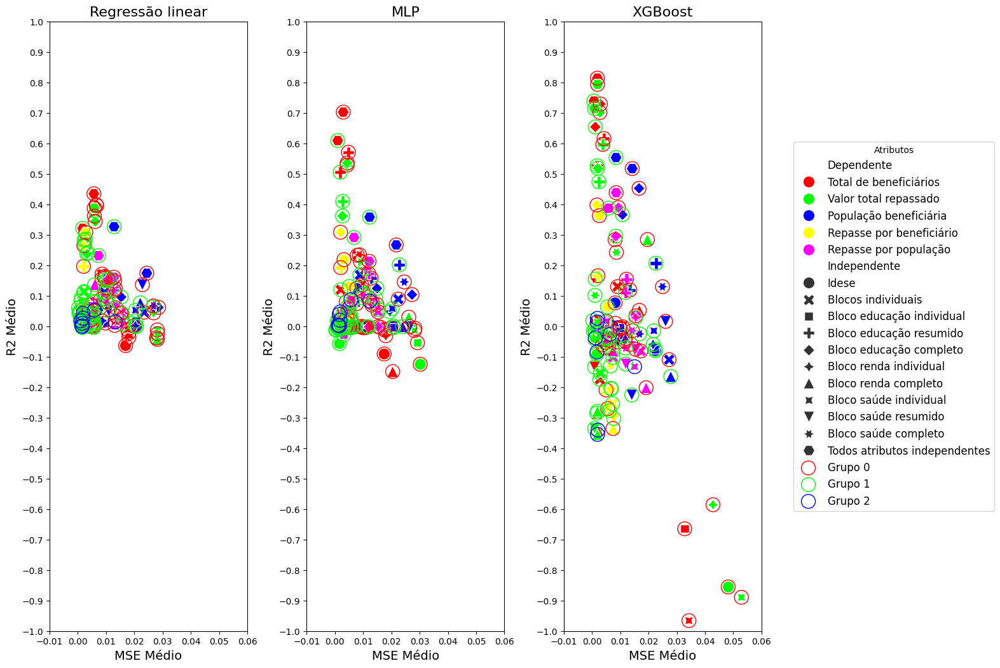

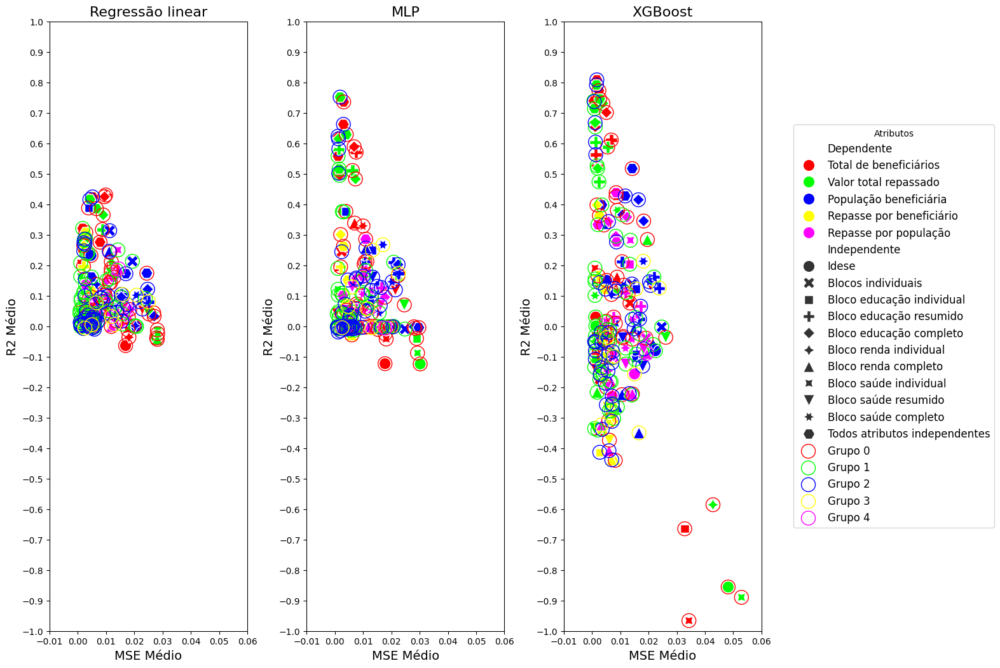

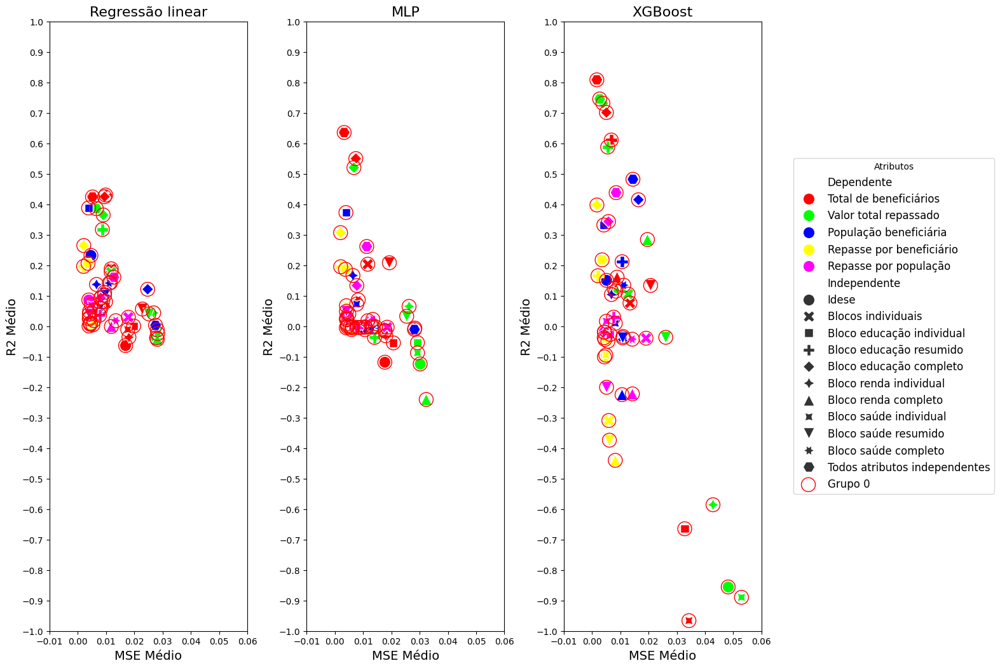

In [28]:
tabelas = ['Resultados_melhor_k','Resultados_segundo_melhor_k','Resultados_grupo_unico']
modelos = ['Regressão linear', 'MLP', 'XGBoost']
cores = ["#FF0000", "#00FF00", "#0000FF", "#FFFF00", "#FF00FF", "#00FFFF", "#FFA500", "#800080", "#32CD32", "#A52A2A", "#000000"]

for t in tabelas:
    tabela = pd.read_csv(t+'.csv',sep=',', encoding='latin-1')
    fig, axes = plt.subplots(1, 3, figsize=(14, 12))
    
    for i, modelo in enumerate(modelos):
        dados_modelo = tabela[tabela['Modelo'] == modelo].copy()
        grupos = dados_modelo['Grupo'].unique()
        num_grupos = len(grupos)
        cores_contorno = ["#FF0000", "#00FF00", "#0000FF", "#FFFF00", "#FF00FF", "#00FFFF", "#FFA500", "#800080", "#32CD32", "#A52A2A", "#000000"]
        contorno_dict = {grupo: cor for grupo, cor in zip(grupos, cores_contorno[:num_grupos])}
        
        sns.scatterplot(data=dados_modelo, x='MSE médio', y='R2 médio', hue='Dependente', style='Independente', palette=cores[:len(dados_modelo['Dependente'].unique())], s=180, ax=axes[i])
        
        for grupo, cor in contorno_dict.items():
            mask = dados_modelo['Grupo'] == grupo
            axes[i].scatter(dados_modelo.loc[mask, 'MSE médio'], dados_modelo.loc[mask, 'R2 médio'], facecolors='none', edgecolors=cor, linewidth=1, s=250, label=f'Grupo {grupo}')

        axes[i].set_title(f'{modelo}', fontsize=16)
        axes[i].set_xlabel('MSE Médio', fontsize=14)
        axes[i].set_ylabel('R2 Médio',fontsize=14)
        axes[i].set_ylim(-1, 1)
        axes[i].set_yticks([i/10 for i in range(-10, 11)])
        axes[i].tick_params(axis='y', labelsize=10)
        axes[i].set_xlim(-0.01, 0.06)
        axes[i].legend().remove()

    handles, labels = axes[0].get_legend_handles_labels()
    # fig.suptitle(f'{t.replace("_"," ")}',fontsize=20)
    
    plt.subplots_adjust(left=0.05, right=0.85, top=0.9, bottom=0.1, wspace=0.3)
    fig.legend(handles, labels, bbox_to_anchor=(0.88, 0.5), loc='center left', title='Atributos',fontsize=12, frameon=True)
    plt.savefig(f'graficos/modelos_{t}', dpi=520, bbox_inches='tight')
    
    plt.show()

# **Extração dos melhores

## **10 melhores

In [40]:
# tabelas = ['Resultados_melhor_k']#,'Resultados_segundo_melhor_k','Resultados_grupo_unico']
tabelas = ['Resultados_segundo_melhor_k']
# tabelas = ['Resultados_grupo_unico']
qnt_resultados = 15

for t in tabelas:
    resultados = pd.read_csv(t+'.csv', sep=',', encoding='latin-1')
    resultados = resultados.sort_values(by='R2 médio', ascending=False)

    print(f'10 Melhores de: {t.replace('_', ' ').upper()}')
    print()
    print(resultados.nlargest(qnt_resultados, 'R2 médio').to_string(index=False))
    print()

10 Melhores de: RESULTADOS SEGUNDO MELHOR K

            Dependente                  Independente  Modelo  Grupo  R2 médio  R2 desvio  MSE médio  MSE desvio  Tempo de execução
Total de beneficiários Todos atributos independentes XGBoost      2  0.808340   0.045333   0.001710    0.000241           2.513144
 Valor total repassado Todos atributos independentes XGBoost      2  0.791457   0.083090   0.001582    0.001006           1.832649
Total de beneficiários Todos atributos independentes XGBoost      0  0.772811   0.072280   0.002438    0.000677           1.975175
 Valor total repassado Todos atributos independentes     MLP      2  0.751670   0.056603   0.001855    0.000889          22.735872
 Valor total repassado Todos atributos independentes XGBoost      0  0.745555   0.030324   0.002715    0.000572           2.640276
Total de beneficiários Todos atributos independentes XGBoost      1  0.738800   0.062786   0.000649    0.000148           2.865838
Total de beneficiários       Bloco edu

In [16]:
# tabelas = ['Resultados_melhor_k']#,'Resultados_segundo_melhor_k','Resultados_grupo_unico']
# tabelas = ['Resultados_melhor_k','Resultados_segundo_melhor_k','Resultados_grupo_unico']
# tabelas = ['Resultados_segundo_melhor_k']
tabelas = ['Resultados_grupo_unico']
qnt_resultados = 3

for t in tabelas:
    resultados = pd.read_csv(t+'.csv', sep=',', encoding='latin-1')
    resultados = resultados.groupby('Modelo').get_group('Regressão linear')
    resultados = resultados.sort_values(by='R2 médio', ascending=False)

    print(f'10 Melhores de: {t.replace('_', ' ').upper()}')
    print()
    print(resultados.nlargest(qnt_resultados, 'R2 médio').to_string(index=False))
    print()

10 Melhores de: RESULTADOS GRUPO UNICO

            Dependente                  Independente           Modelo  Grupo  R2 médio  R2 desvio  MSE médio  MSE desvio  Tempo de execução
Total de beneficiários       Bloco educação resumido Regressão linear      0   0.43051   0.058938   0.009881    0.002889           0.010741
Total de beneficiários       Bloco educação completo Regressão linear      0   0.42495   0.057271   0.009490    0.001603           0.011188
Total de beneficiários Todos atributos independentes Regressão linear      0   0.42419   0.039874   0.005221    0.000411           0.015852



## **Análise dos grupos**

In [83]:
data = carregarDados(1)
# Vamos extrarir os dados dos 5 melhores resultados que estão contidos na tabela do melhor_k e segundo_melhor_k
tabelas = ['Resultados_melhor_k','Resultados_segundo_melhor_k'] #,'Resultados_grupo_unico']
# tabelas = ['Resultados_segundo_melhor_k'] #,'Resultados_grupo_unico']
qnt_resultados = 15

for t in tabelas:
    resultados = pd.read_csv(t+'.csv', sep=',', encoding='latin-1')
    resultados = resultados.sort_values(by='R2 médio', ascending=False)
    data_extract = resultados.nlargest(qnt_resultados, 'R2 médio')
    print(f'{t.upper()}')
    for i in range(qnt_resultados):
        linha = data_extract.iloc[i]
        dependente = linha['Dependente']
        independente = linha['Independente']
        qnt_grupos = resultados[(resultados['Dependente'] == dependente) & (resultados['Independente'] == independente)]['Grupo'].nunique()
        
        var_ind = atributosValores(independente)
        var_dep = atributosValores(dependente)
        grupo_alvo = linha['Grupo']
        
        kmeans_atributos = var_dep + var_ind
        atributos_completos = var_dep + var_ind + ibge + populacao
        
        data_k = data[kmeans_atributos].copy()
        data_apresentar = data[atributos_completos].copy()
        
        scaller = MinMaxScaler()
        k_data = pd.DataFrame(scaller.fit_transform(data_k), columns=data_k.columns)
        model_kmeans = KMeans(n_clusters=qnt_grupos, random_state=r_state)
        grupos = model_kmeans.fit_predict(k_data)
        data_apresentar['Grupo'] = grupos

        grupo_dados = data_apresentar[data_apresentar['Grupo'] == grupo_alvo]
        grupo_dados_dependente = grupo_dados[var_dep].mean()
        grupo_dados_independente = grupo_dados[var_ind].mean()
        grupo_dados_populacao = grupo_dados[populacao].mean()
        media_dependente = data[var_dep].mean()
        grupo_dados_ibge_micro = grupo_dados['Nome microrregiao'].value_counts()
        grupo_dados_ibge_meso = grupo_dados['Nome mesorregiao'].value_counts()
        
        # Adicionar porcentagens para microrregião
        contagem_micro = grupo_dados['Nome microrregiao'].value_counts()
        porcentagem_micro = (contagem_micro / len(grupo_dados) * 100).round(2)
        grupo_dados_ibge_micro = pd.DataFrame({
            'Amostras': contagem_micro,
            'Porcentagem (%)': porcentagem_micro
        })
        # Adicionar porcentagens para mesorregião
        contagem_meso = grupo_dados['Nome mesorregiao'].value_counts()
        porcentagem_meso = (contagem_meso / len(grupo_dados) * 100).round(2)
        grupo_dados_ibge_meso = pd.DataFrame({
            'Amostras': contagem_meso,
            'Porcentagem (%)': porcentagem_meso
        })

        media_original = data[var_ind].mean()
        porcentagem_equivalente = ((grupo_dados_independente / media_original) - 1) * 100
        grupo_dados_independente = pd.DataFrame({
            'Grupo': grupo_dados_independente.round(4),
            'Original': media_original.round(4),
            'Erro(%)': porcentagem_equivalente.round(2)
        })
        
        qnt_amostras_grupo = len(grupo_dados)
        
        print(f"Combinação:{linha['Dependente']} | {linha['Independente']} \n Modelo: {linha['Modelo']} |  Grupo: {linha['Grupo']}")
        print(f"R² Médio: {linha['R2 médio']} |  MSE Médio: {linha['MSE médio']}")
        # print(f'\n Informações das amostras')
        print(f"Amostras no grupo: {qnt_amostras_grupo}")
        # print(f" Amostras por microrregião:\n{grupo_dados_ibge_micro.to_string()}\n")
        # print(f" Amostras por mesorregião:\n{grupo_dados_ibge_meso.to_string()}\n")
        print(f"População média: {grupo_dados_populacao['População']:.2f}\n")
        print(f'Informações médias das amostras:')
        print(f'{dependente}: {grupo_dados_dependente.iloc[0]:.2f}\n Equivalente a ({(((grupo_dados_dependente.iloc[0] / media_dependente.iloc[0])-1)*100):.2f}%) do valor médio: ({media_dependente.iloc[0]:.2f})')
        print(f'Características IDESE:\n{grupo_dados_independente.to_string()}\n')
        # print(' ============================\n')

RESULTADOS_MELHOR_K
Combinação:Total de beneficiários | Todos atributos independentes 
 Modelo: XGBoost |  Grupo: 0
R² Médio: 0.813919 |  MSE Médio: 0.001896
Amostras no grupo: 3220
População média: 23876.88

Informações médias das amostras:
Total de beneficiários: 1134.43
 Equivalente a (37.50%) do valor médio: (825.03)
Características IDESE:
                                   Grupo  Original  Erro(%)
Idese                             0.6670    0.7253    -8.04
Bloco Educação                    0.6264    0.6914    -9.40
Bloco Renda                       0.5698    0.6482   -12.09
Bloco Saúde                       0.8048    0.8363    -3.77
Anos Finais EF                    0.6418    0.6780    -5.34
Anos Iniciais EF                  0.7030    0.7608    -7.60
Ensino Fundamental                0.6724    0.7194    -6.54
Ensino Médio                      0.7119    0.7607    -6.43
Escolaridade Adulta               0.4135    0.4538    -8.86
Pré Escola                        0.7077    0.8317   -

## **Graificos dos clusters**

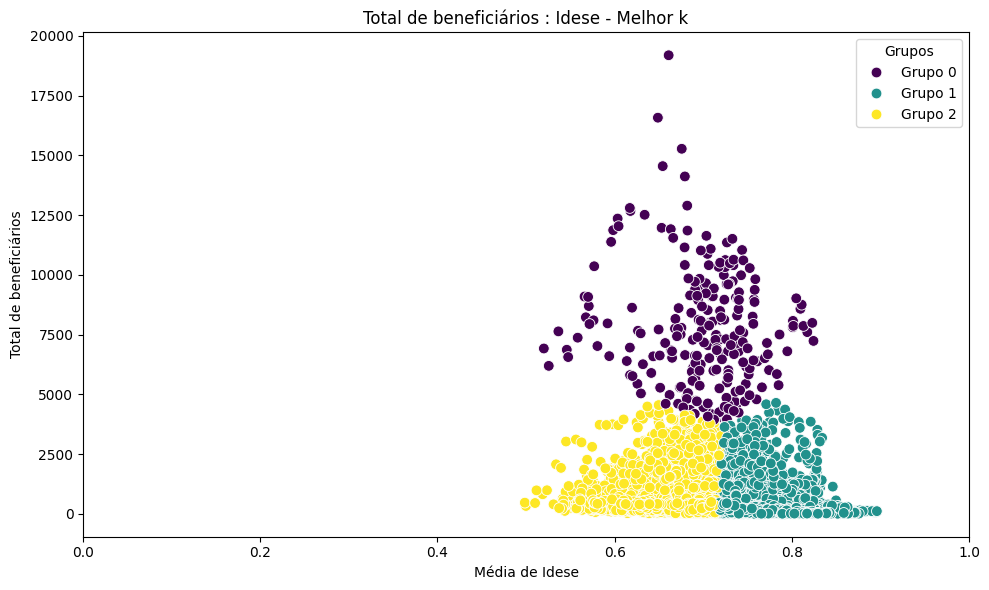

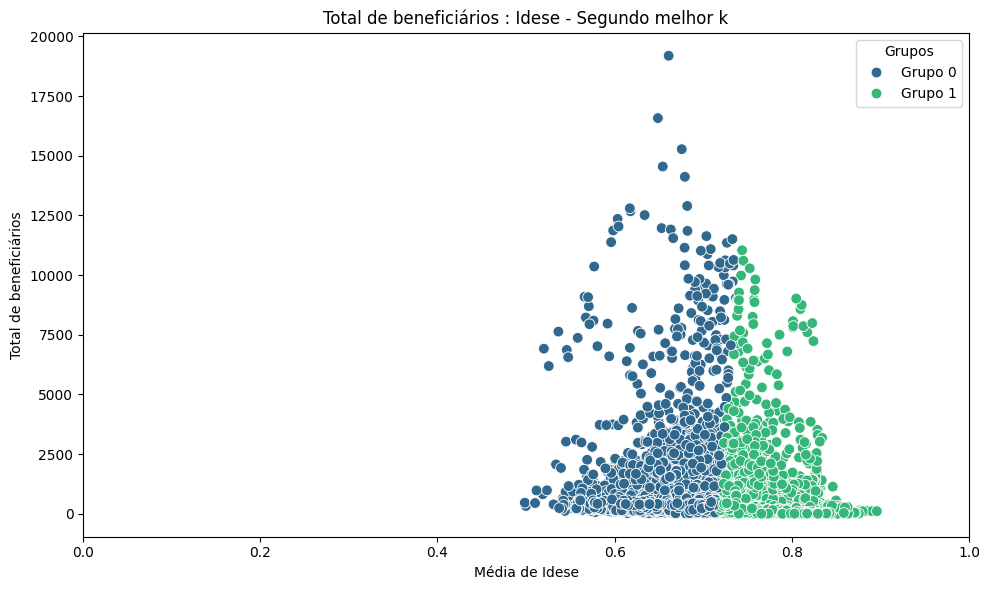

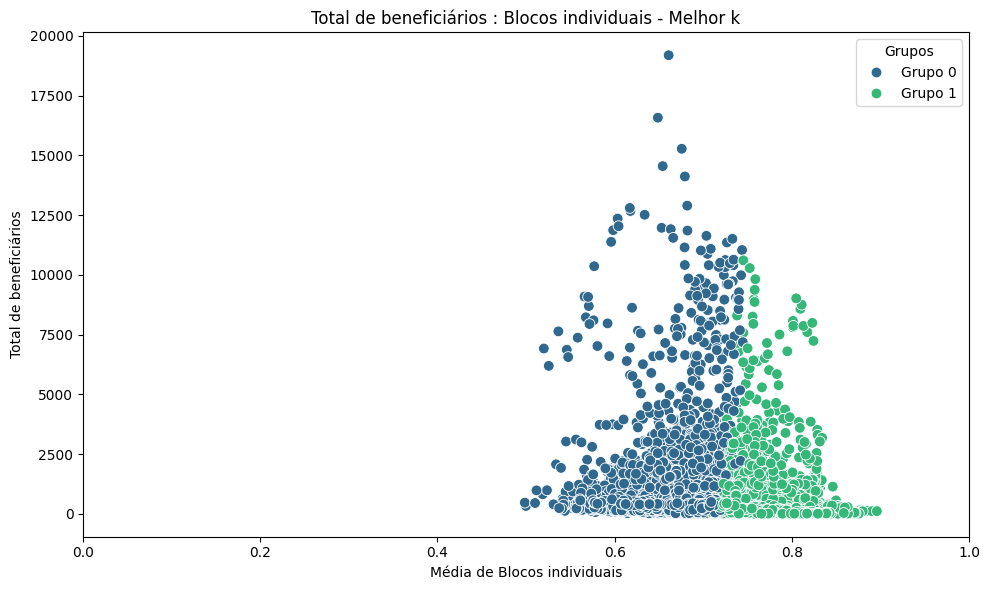

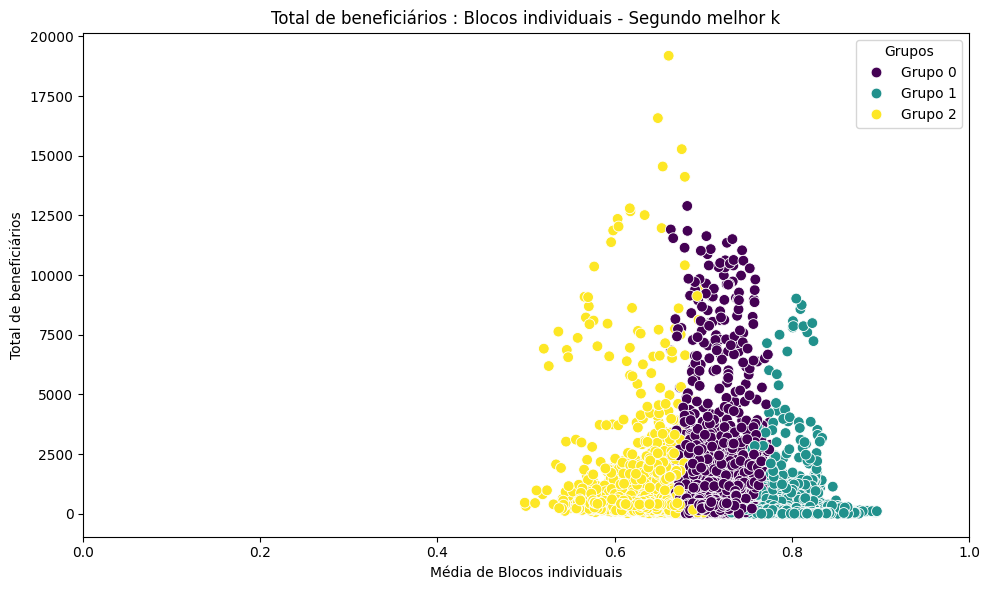

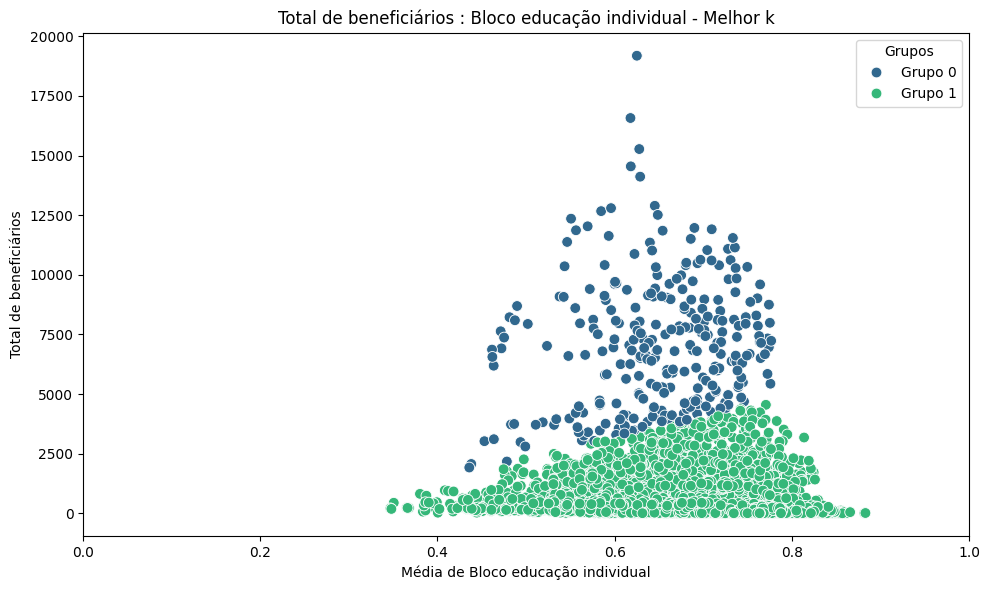

...

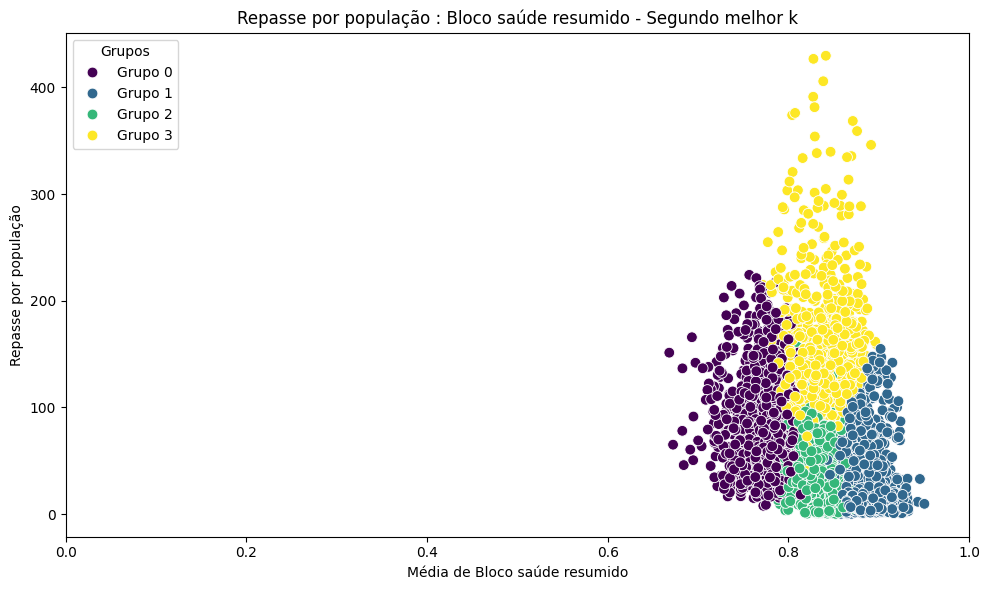

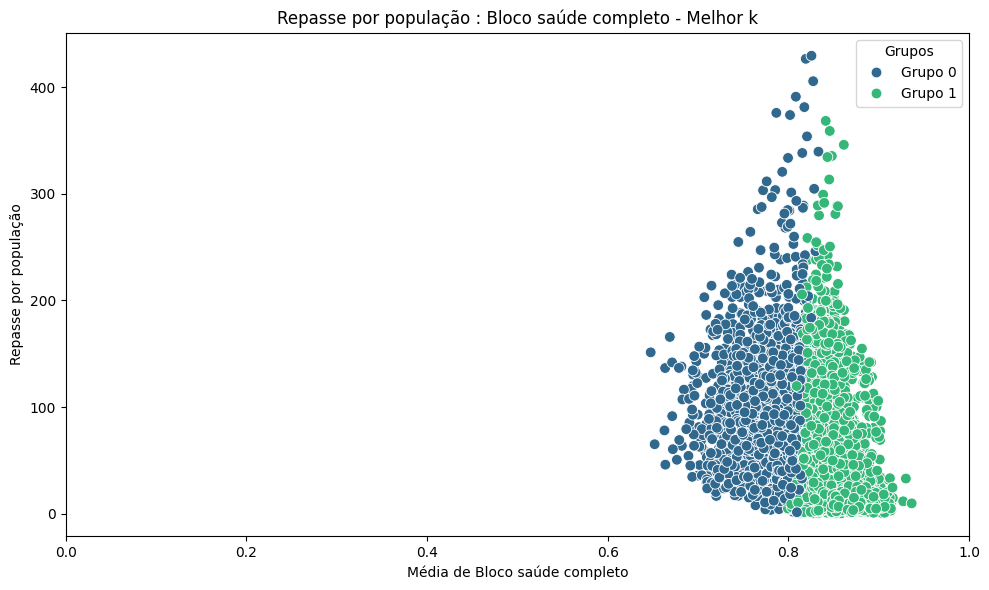

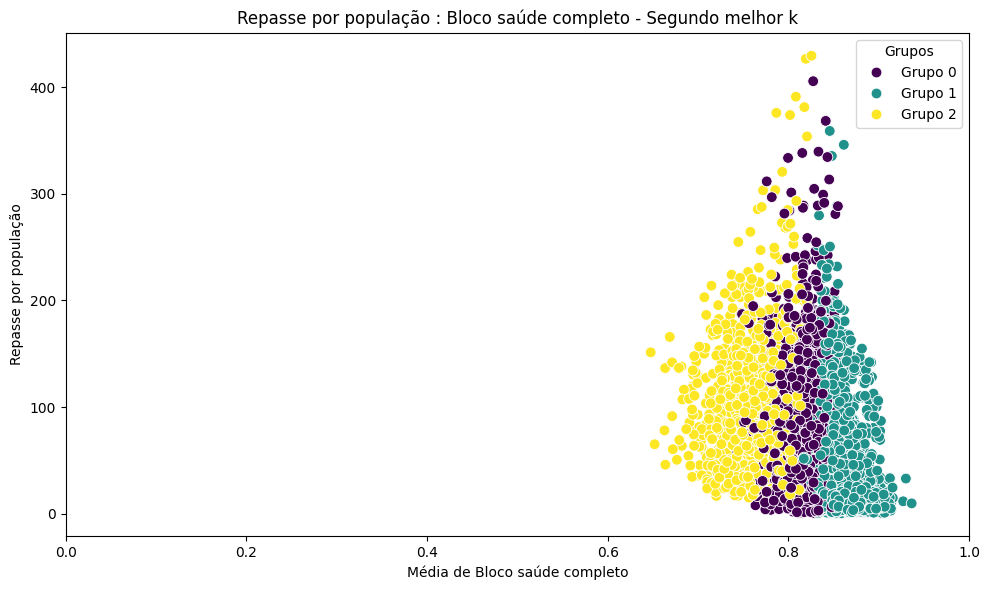

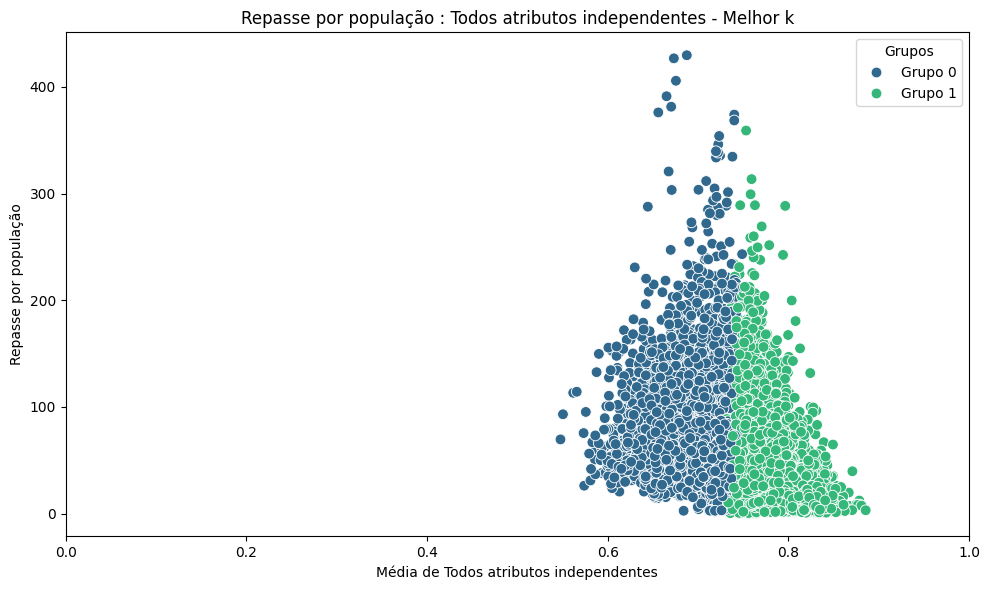

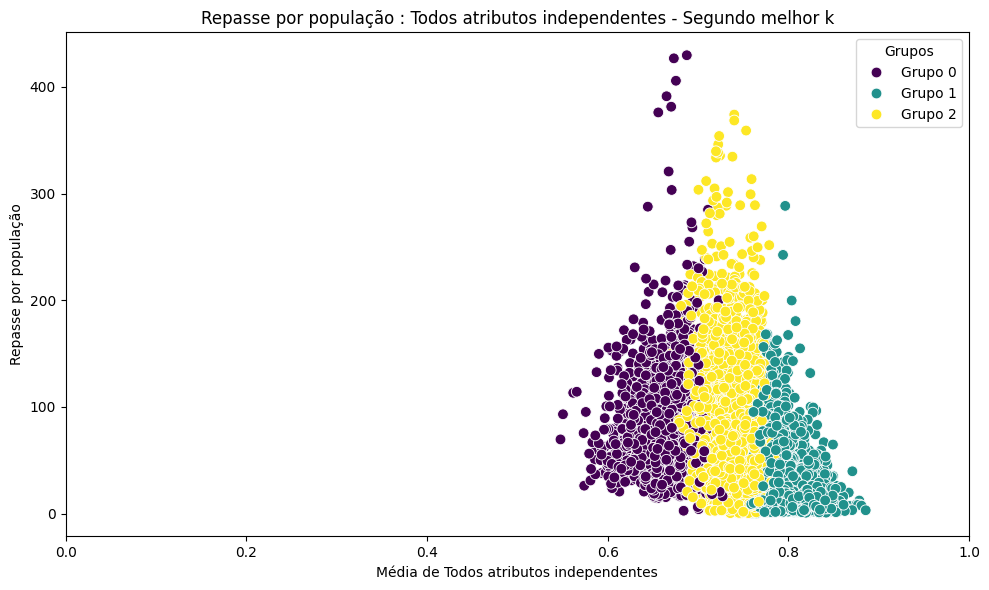

In [28]:
for dependente in list(dependentesTeste):
    for independente in list(independentesTeste):
        # Mostrar qual teste está sendo executado
        var_ind = independenteNome(independente)
        
        atributos = dependente+ independente # Concatenação das colunas de atributos
        data_teste_1 = data[atributos].copy()
        data_teste_2 = data[atributos].copy()
        
        # # ESCALAONADORES
        scaller = MinMaxScaler()
        k_data = pd.DataFrame(scaller.fit_transform(data_teste_1), columns=data_teste_1.columns)
        sil_scores = []
        range_k = range(2, 8)
        for k in range_k:
            kmeans = KMeans(n_clusters=k, random_state=r_state)
            labels = kmeans.fit_predict(k_data)
            score = silhouette_score(k_data, labels)
            sil_scores.append(score)
        
        melhor_k_val = max(sil_scores)
        segundo_melhor_val = sorted(sil_scores)[-2] 
        melhor_k = range_k[sil_scores.index(melhor_k_val)]
        segundo_melhor_k = range_k[sil_scores.index(segundo_melhor_val)]
        
        # APLICAR O K-MEANS NA "MELHOR" DIVISÃO ENCONTRADA PELO SILHUETA
        model_kmeans = KMeans(n_clusters = melhor_k, random_state = r_state)
        grupos = model_kmeans.fit_predict(k_data)
        data_teste_1['Grupos'] = grupos # Distribuir os rotulos dos grupos para a base original
        
        # APLICAR O K-MEANS NA "SEGUNDO MELHOR" DIVISÃO ENCONTRADA PELO SILHUETA
        model_kmeans_2 = KMeans(n_clusters = segundo_melhor_k, random_state = r_state)
        grupos = model_kmeans_2.fit_predict(k_data)
        data_teste_2['Grupos'] = grupos # Distribuir os rotulos dos grupos para a base original

        # Primeira figura
        plt.figure(figsize=(10, 6))
        sns.scatterplot(data=data_teste_1, x=independente[0] if len(independente) == 1 else data_teste_1[independente].mean(axis=1), y=dependente[0], hue='Grupos', palette='viridis', s=60)
        plt.title(f'{dependente[0]} : {var_ind} - Melhor k')
        plt.xlabel(f'Média de {var_ind}')
        plt.ylabel(f'{dependente[0]}')
        plt.xlim(0, 1)
        handles, labels = plt.gca().get_legend_handles_labels()
        new_labels = [f'Grupo {label}' for label in labels]
        plt.legend(handles, new_labels, title='Grupos')
        plt.tight_layout()
        plt.savefig(f"graficos/clusters/MK-{dependente[0]}-{var_ind}.png", dpi=500, bbox_inches="tight")
        plt.show()
        
        # Segunda figura
        plt.figure(figsize=(10, 6))
        sns.scatterplot(data=data_teste_2, x=independente[0] if len(independente) == 1 else data_teste_1[independente].mean(axis=1), y=dependente[0], hue='Grupos', palette='viridis', s=60)
        plt.title(f'{dependente[0]} : {var_ind} - Segundo melhor k')
        plt.xlabel(f'Média de {var_ind}')
        plt.ylabel(f'{dependente[0]}')
        plt.xlim(0, 1)
        handles, labels = plt.gca().get_legend_handles_labels()
        new_labels = [f'Grupo {label}' for label in labels]
        plt.legend(handles, new_labels, title='Grupos')
        plt.tight_layout()
        plt.savefig(f"graficos/clusters/SMK-{dependente[0]}-{var_ind}.png", dpi=500, bbox_inches="tight")
        plt.show()
        

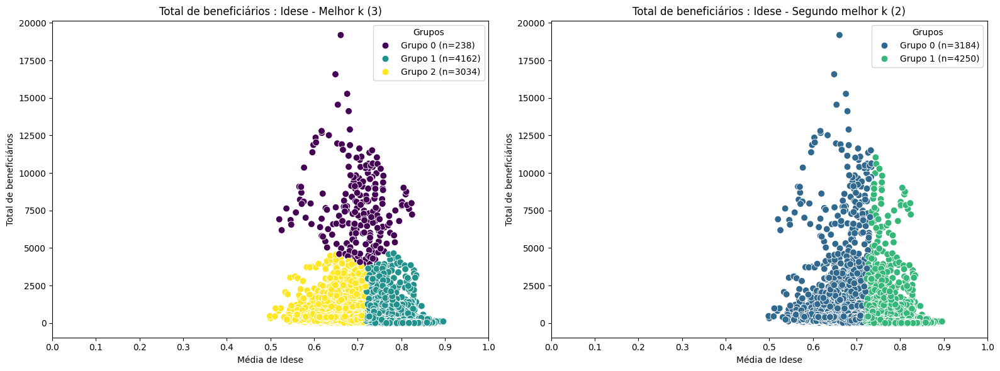

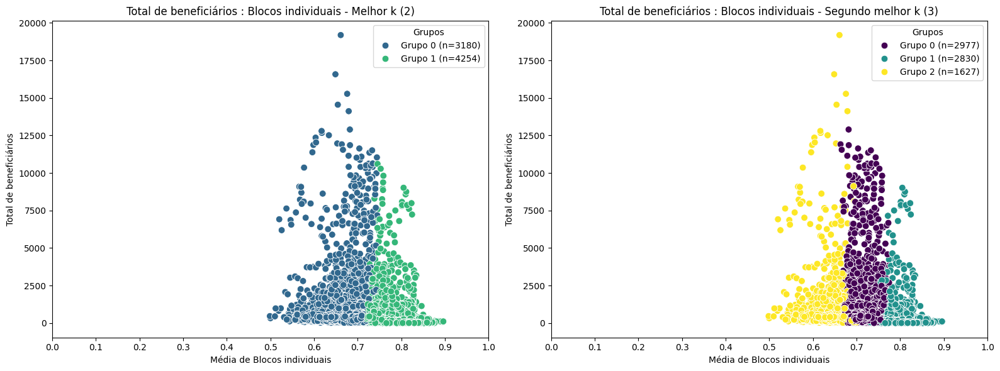

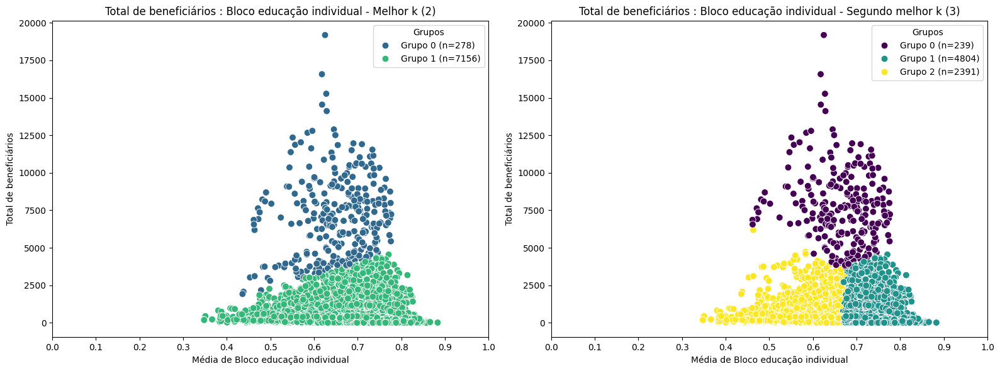

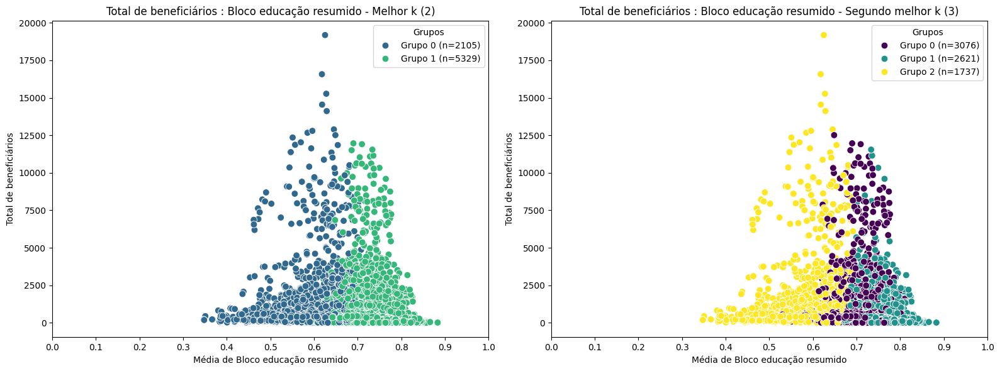

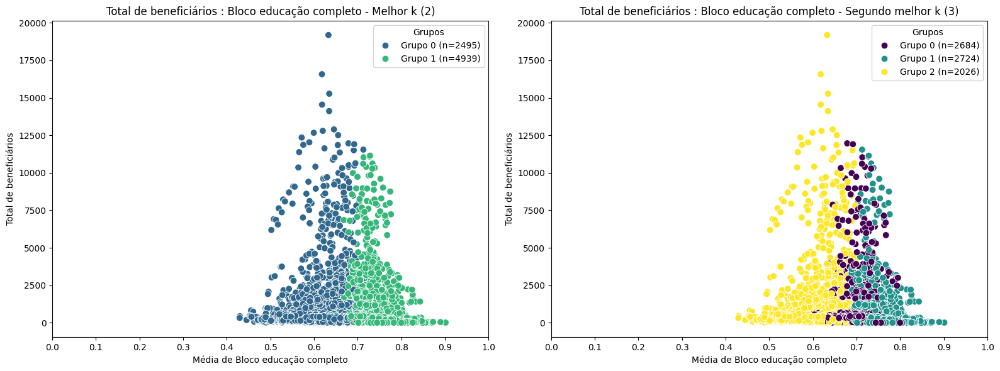

...

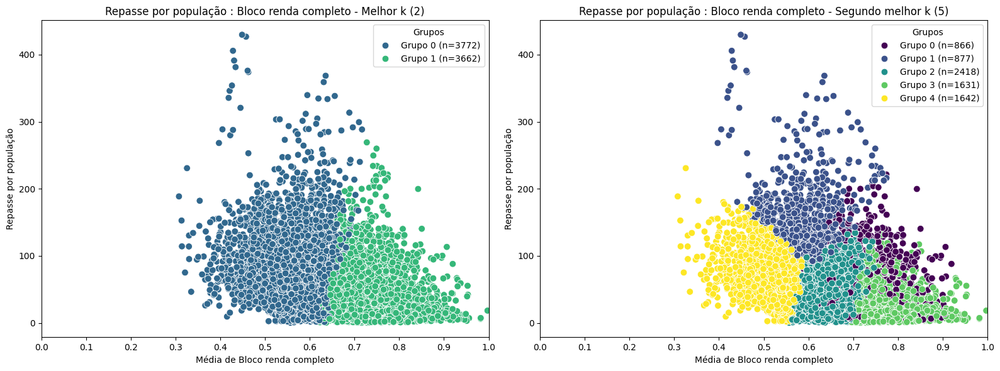

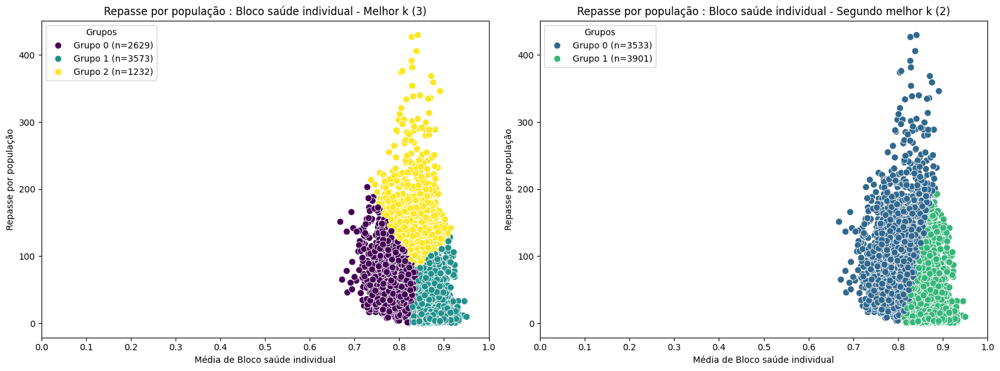

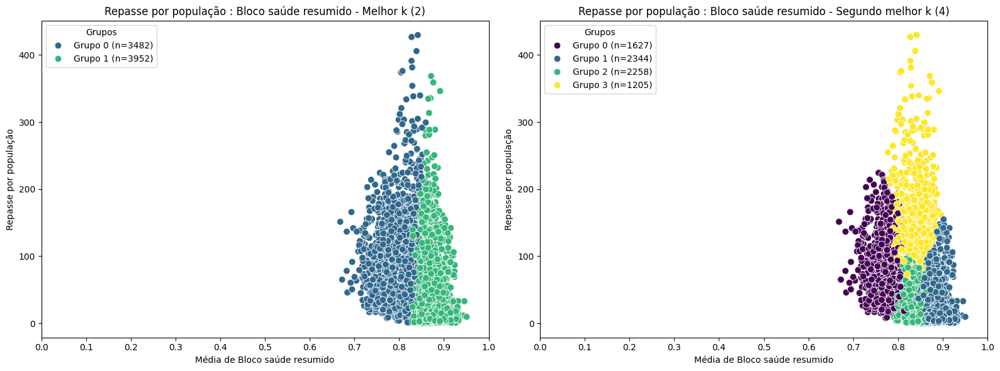

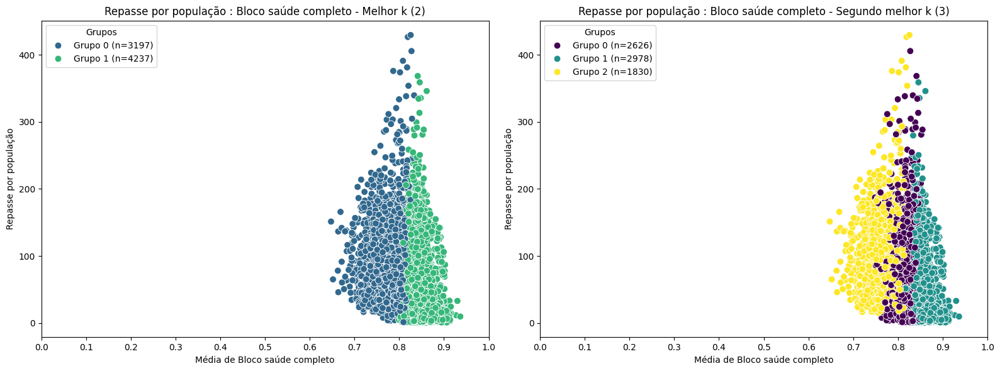

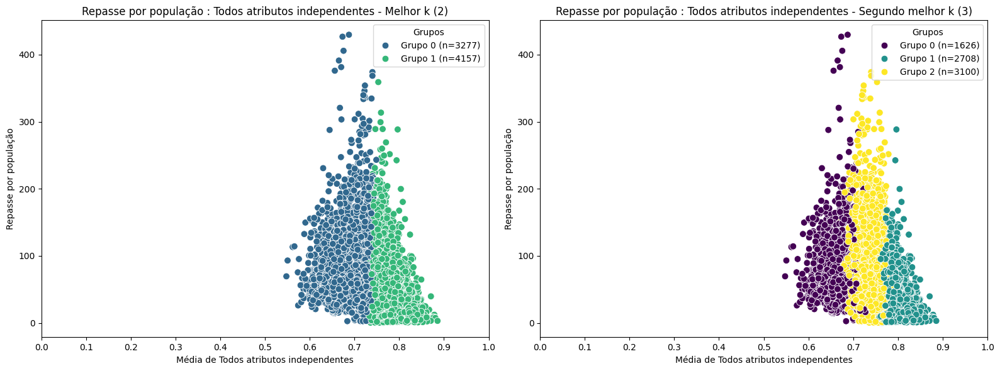

In [29]:
# graficos dos cluster em dupla
for dependente in list(dependentesTeste):
    for independente in list(independentesTeste):
        var_ind = independenteNome(independente)
        
        atributos = dependente + independente
        data_teste_1 = data[atributos].copy()
        data_teste_2 = data[atributos].copy()
        
        scaller = MinMaxScaler()
        k_data = pd.DataFrame(scaller.fit_transform(data_teste_1), columns=data_teste_1.columns)
        sil_scores = []
        range_k = range(2, 8)
        for k in range_k:
            kmeans = KMeans(n_clusters=k, random_state=r_state)
            labels = kmeans.fit_predict(k_data)
            score = silhouette_score(k_data, labels)
            sil_scores.append(score)
        
        melhor_k_val = max(sil_scores)
        segundo_melhor_val = sorted(sil_scores)[-2] 
        melhor_k = range_k[sil_scores.index(melhor_k_val)]
        segundo_melhor_k = range_k[sil_scores.index(segundo_melhor_val)]
        
        model_kmeans = KMeans(n_clusters=melhor_k, random_state=r_state)
        grupos = model_kmeans.fit_predict(k_data)
        data_teste_1['Grupos'] = grupos
        
        model_kmeans_2 = KMeans(n_clusters=segundo_melhor_k, random_state=r_state)
        grupos = model_kmeans_2.fit_predict(k_data)
        data_teste_2['Grupos'] = grupos

        # Figura única com duas subplots
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
        
        # Primeiro gráfico - Melhor K
        sns.scatterplot(data=data_teste_1, x=independente[0] if len(independente) == 1 else data_teste_1[independente].mean(axis=1), 
                       y=dependente[0], hue='Grupos', palette='viridis', s=60, ax=ax1)
        ax1.set_title(f'{dependente[0]} : {var_ind} - Melhor k ({melhor_k})')
        ax1.set_xlabel(f'Média de {var_ind}')
        ax1.set_ylabel(f'{dependente[0]}')
        ax1.set_xlim(0, 1)
        ax1.set_xticks(np.arange(0, 1.1, 0.1))
        handles1, labels1 = ax1.get_legend_handles_labels()
        counts1 = data_teste_1['Grupos'].value_counts().sort_index()
        new_labels1 = [f'Grupo {label} (n={counts1[int(label)]})' for label in labels1]
        ax1.legend(handles1, new_labels1, title='Grupos')
        
        # Segundo gráfico - Segundo melhor K
        sns.scatterplot(data=data_teste_2, x=independente[0] if len(independente) == 1 else data_teste_2[independente].mean(axis=1), 
                       y=dependente[0], hue='Grupos', palette='viridis', s=60, ax=ax2)
        ax2.set_title(f'{dependente[0]} : {var_ind} - Segundo melhor k ({segundo_melhor_k})')
        ax2.set_xlabel(f'Média de {var_ind}')
        ax2.set_ylabel(f'{dependente[0]}')
        ax2.set_xlim(0, 1)
        ax2.set_xticks(np.arange(0, 1.1, 0.1))
        handles2, labels2 = ax2.get_legend_handles_labels()
        counts2 = data_teste_2['Grupos'].value_counts().sort_index()
        new_labels2 = [f'Grupo {label} (n={counts2[int(label)]})' for label in labels2]
        ax2.legend(handles2, new_labels2, title='Grupos')
        
        plt.tight_layout()
        plt.savefig(f"graficos/clusters/COMBO-{dependente[0]}-{var_ind}.png", dpi=500, bbox_inches="tight")
        plt.show()
        